ENSEMBLE LEARNING | MACHINE LEARNING II
## Feb 2023
--- 

---
Importamos todos los paquetes aquí por comodidad

In [1]:
#-------------------------- NO ESCRIBAS LÍNEAS DE CÓDIGO MÁS LARGAS QUE LO QUE OCUPA ESTA LÍNEA -----------------------------|
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

from sklearn.pipeline import Pipeline, make_pipeline
from sklearn import metrics
from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import VotingClassifier, StackingClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.metrics import ConfusionMatrixDisplay, confusion_matrix
from sklearn.preprocessing import StandardScaler
from sklearn.compose import ColumnTransformer

import pickle

from sklearn.tree import DecisionTreeClassifier, plot_tree, export_text
from sklearn.inspection import permutation_importance
from sklearn.ensemble import BaggingClassifier
from sklearn.decomposition import PCA

from mltools import model_tools as MT
from mltools import classification_tools as CT

from collections import Counter

c:\Users\juanm\miniconda3\envs\ml\lib\site-packages\scipy\__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.23.5
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


### 1. AJUSTE DE LOS MODELOS CON EL DATASET AJU_DATOS_DEM_C3

Se trata de estimar la variable FESTIVO (1: el día es festivo) a partir de las variables disponibles en el dataset que se consideren oportunas. NO se pueden utilizar como variables de entrada: FECHA, DIA ni ANNO. La FECHA es interesante manejarla simplemente como ayuda para entender lo que esté pasando.

Se deben ajustar diferentes modelos, buscando un buen compromiso entre la complejidad y el error en cada uno de ellos. El objetivo es conseguir un buen modelo con una gran capacidad de acierto en el futuro. Modelos que deben crearse, analizando los resultados de cada uno de ellos (errores e importancias de las variables):
- Simple tree
- Bagged  tree
- Random Forest
- Gradient boosting
- Stacking

Carga de datos

In [69]:
#-------------------------- NO ESCRIBAS LÍNEAS DE CÓDIGO MÁS LARGAS QUE LO QUE OCUPA ESTA LÍNEA -----------------------------|

df_aju = pd.read_csv('AJU_DATOS_DEM_C3.csv')

# parseamos la fecha (cadena) para que sea un datetime con formato dd/mm/yyyy 
# esta variable NO se puede utilizar como entrada en los modelos
df_aju.FECHA = pd.to_datetime(df_aju.FECHA, format='%d/%m/%Y') 
s=df_aju.loc[:,'FECHA']
df_aju['FECHA'] =  s.dt.date

# eliminamos las variables que no se pueden usar como entradas en los modelos
del df_aju['ANNO']
del df_aju['DIA']

print('Tamaño de df_orig con los datos cargados:', df_aju.shape)
print('Dataframe con todos los datos leidos (filas: días, columnas: variables):')
df_aju

Tamaño de df_orig con los datos cargados: (2879, 30)
Dataframe con todos los datos leidos (filas: días, columnas: variables):


,FECHA,CR00,CR01,CR02,CR03,CR04,CR05,CR06,CR07,CR08,...,CR19,CR20,CR21,CR22,CR23,MES,DIASEM,FESTIVO,TMIN,TMAX
0,2014-01-01,0.040942,0.038985,0.036382,0.034416,0.033409,0.033420,0.034054,0.034229,0.035889,...,0.055197,0.054185,0.051063,0.046240,0.041000,1,3,1,12.3,20.2
1,2014-01-02,0.033950,0.030996,0.029517,0.028966,0.029165,0.030150,0.032944,0.036510,0.041196,...,0.055820,0.054451,0.051482,0.046145,0.040880,1,4,0,12.0,20.1
2,2014-01-03,0.035463,0.032112,0.030292,0.029521,0.029450,0.030515,0.033188,0.036656,0.041052,...,0.055230,0.053520,0.050286,0.045412,0.040025,1,5,0,13.2,21.0
3,2014-01-04,0.035959,0.032772,0.031034,0.030178,0.030135,0.030782,0.032598,0.034982,0.039299,...,0.053757,0.052620,0.049973,0.044970,0.040386,1,6,0,14.4,23.4
4,2014-01-05,0.037506,0.034148,0.031878,0.031126,0.030930,0.031604,0.033066,0.034803,0.038758,...,0.052902,0.051481,0.049655,0.045730,0.040905,1,7,0,12.8,23.1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2874,2021-12-27,0.033180,0.031299,0.030173,0.029493,0.029649,0.030814,0.033925,0.037837,0.042098,...,0.051685,0.050563,0.047267,0.042237,0.037797,12,1,0,16.1,23.0
2875,2021-12-28,0.033823,0.031731,0.030385,0.029950,0.030017,0.031203,0.034708,0.038432,0.042645,...,0.051867,0.050971,0.047718,0.042585,0.037774,12,2,0,16.6,22.7
2876,2021-12-29,0.034475,0.032198,0.030902,0.030441,0.030384,0.031487,0.034454,0.038381,0.042850,...,0.052136,0.050604,0.046788,0.042033,0.037595,12,3,0,14.3,21.3
2877,2021-12-30,0.034345,0.031919,0.030524,0.029991,0.030087,0.031286,0.034384,0.038574,0.042778,...,0.052092,0.050993,0.047587,0.042807,0.038252,12,4,0,13.4,26.4


Visión general de las series

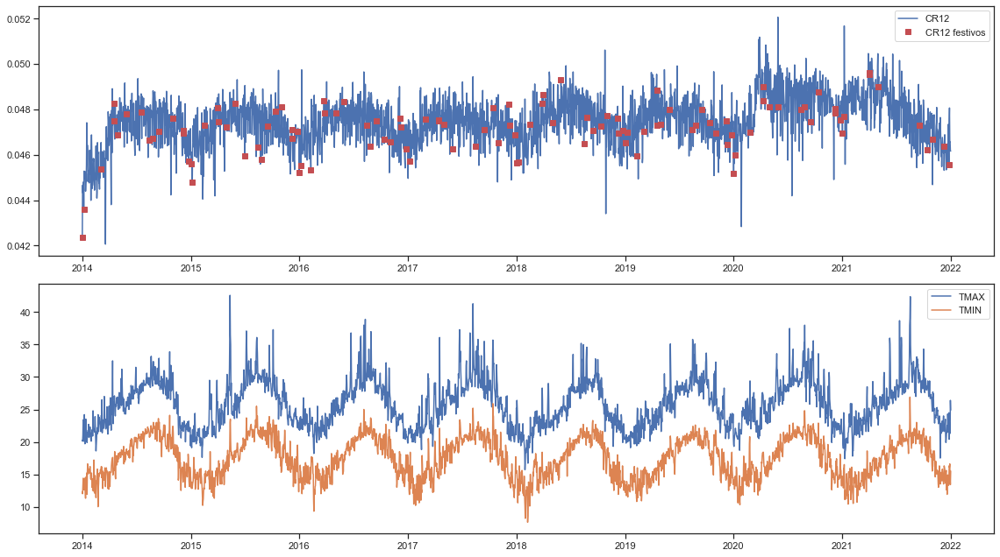

Se observa que el nº de festivos (115) es claramente inferior al nº de laborables (2764)
En concreto, el porcentaje de festivos en el conjunto de ajuste es 3.99444251476207 %


In [70]:
#-------------------------- NO ESCRIBAS LÍNEAS DE CÓDIGO MÁS LARGAS QUE LO QUE OCUPA ESTA LÍNEA -----------------------------|
fig = plt.figure(1, figsize=(16,9))
ax1 = plt.subplot(2,1,1)

ind_festivo = df_aju.FESTIVO == 1

plt.plot(df_aju.FECHA, df_aju.CR12, label='CR12')

plt.plot(df_aju.FECHA[ind_festivo], df_aju.CR12[ind_festivo], 'sr', label='CR12 festivos')
plt.legend()

plt.subplot(2,1,2,sharex= ax1)
plt.plot(df_aju.FECHA, df_aju.TMAX, label='TMAX')
plt.plot(df_aju.FECHA, df_aju.TMIN, label='TMIN')
plt.tight_layout()
plt.legend()

plt.show()

num_festivos = np.count_nonzero(df_aju.FESTIVO)
num_laborables = df_aju.shape[0] - num_festivos
print(f'Se observa que el nº de festivos ({num_festivos}) es claramente inferior al nº de laborables ({num_laborables})')
print(f'En concreto, el porcentaje de festivos en el conjunto de ajuste es {100*num_festivos /  df_aju.shape[0]} %')
# fig.savefig('figura1.pdf')

---
### 1.1 Análisis exploratorio básico del problema

- Incluye un análisis que te permita comprender la naturaleza del problema, cómo son las variables de entrada, su interrelación, así como su relación con la variable de salida
- Comenta todo lo que parezca relevante para el tema tratado, incluyendo todas las gráficas que consideres oportunas
- Estudia cómo se reparten los festivos según el día de la semana y los meses

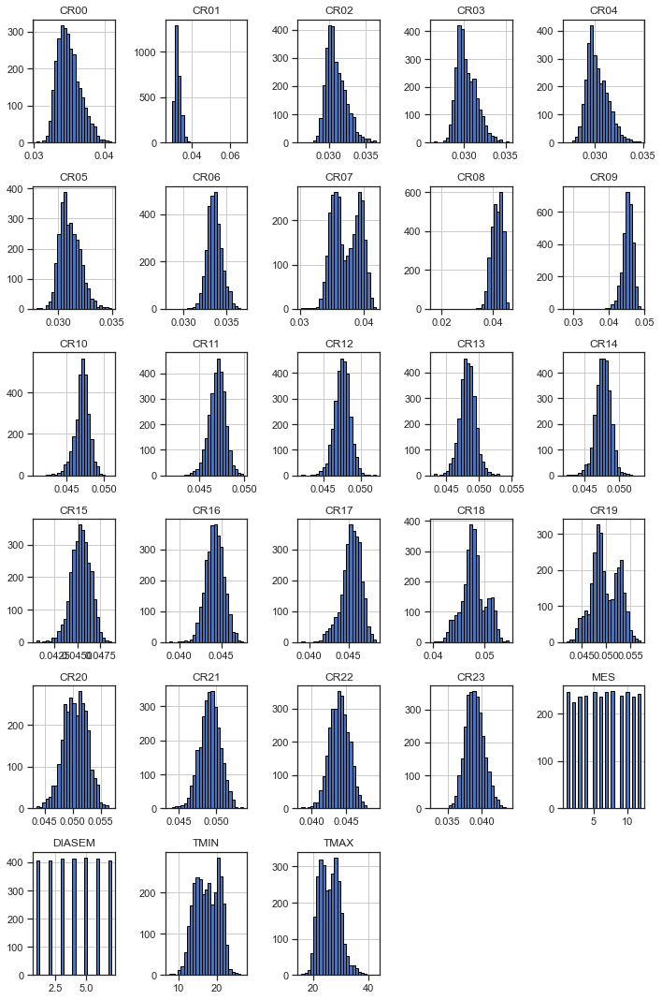

In [66]:
df_aju.hist(bins=25, figsize=(10, 15), layout=(-1, 5), edgecolor="black")
plt.tight_layout()

Las distribuciones de las variables CR parecen ser aproximadamente normales a excepción de CR01, CR07, CR08, CR09 Y CR19. Estas variables deberían ser transformadas para conseguir la normalidad si se desea gacer uso de sus propiedades.


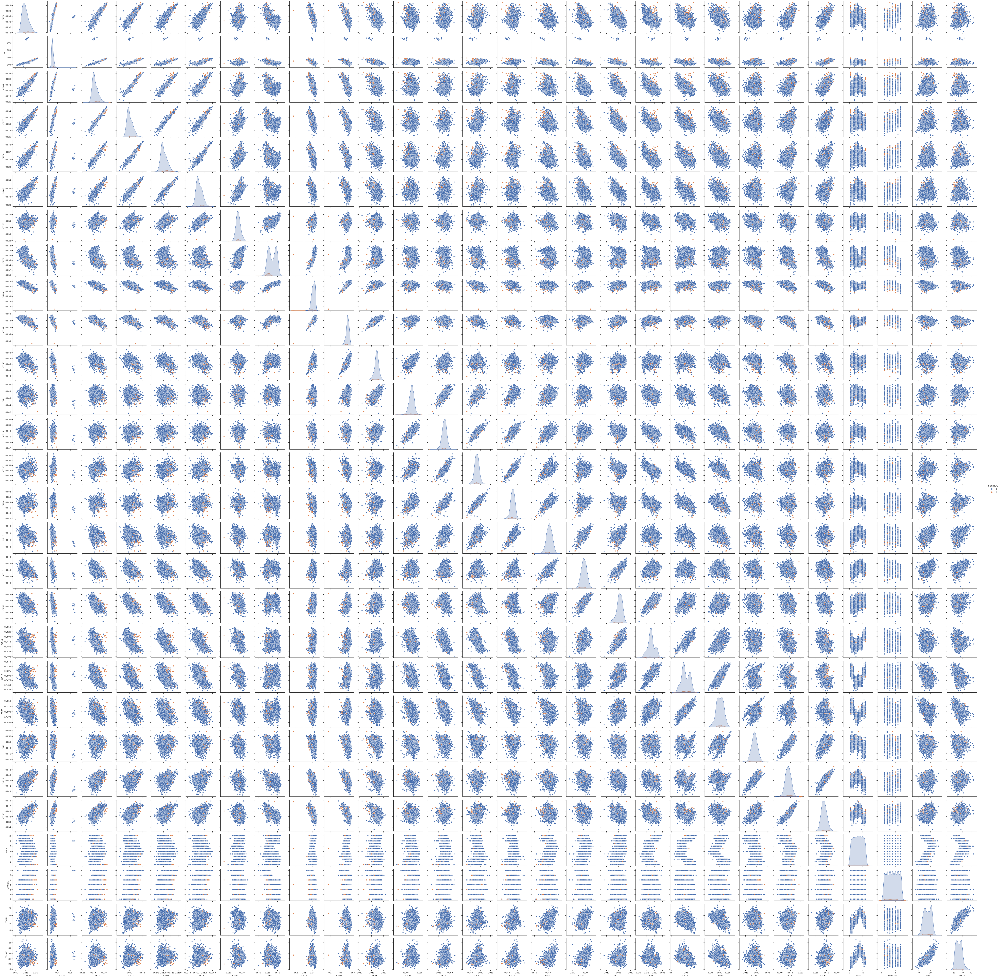

In [67]:
sns.pairplot(df_aju, hue='FESTIVO')

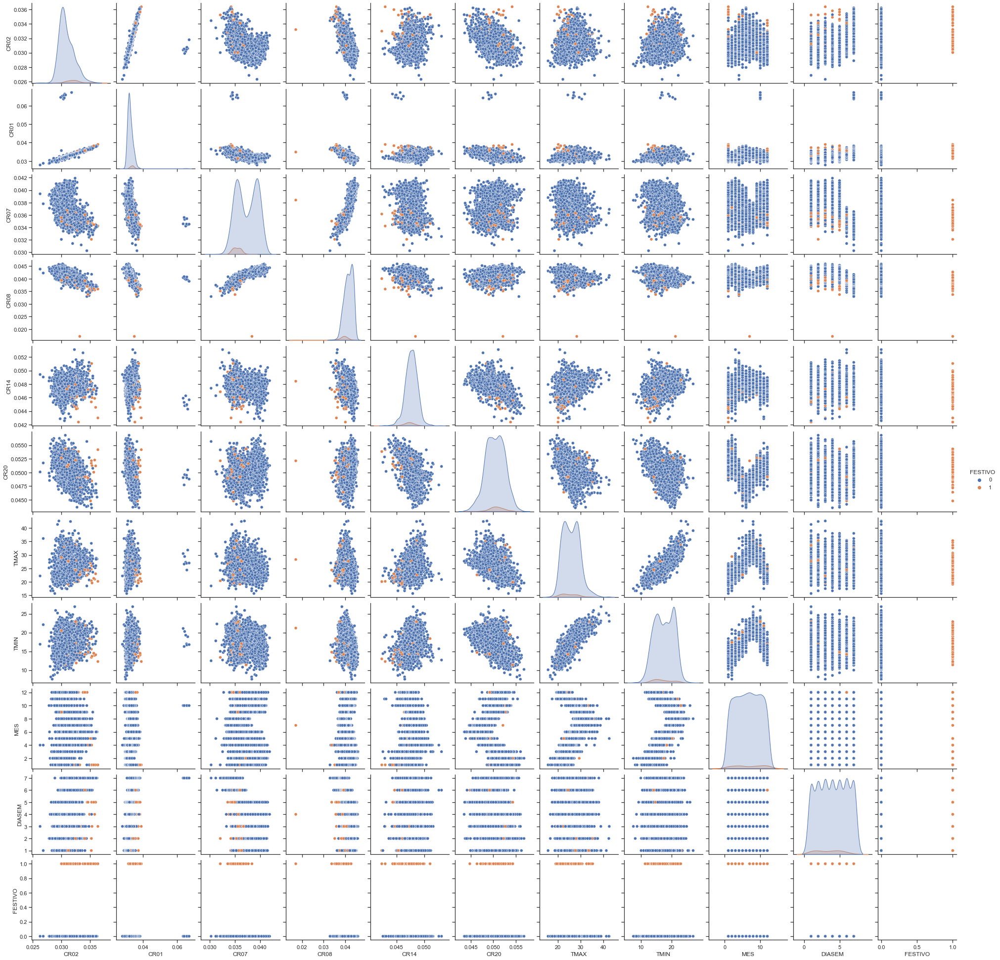

In [71]:
sns.pairplot(df_aju, hue='FESTIVO', vars=['CR02', 'CR01', 'CR07','CR08','CR14', 'CR20', 'TMAX', 'TMIN', 'MES', 'DIASEM', 'FESTIVO'])

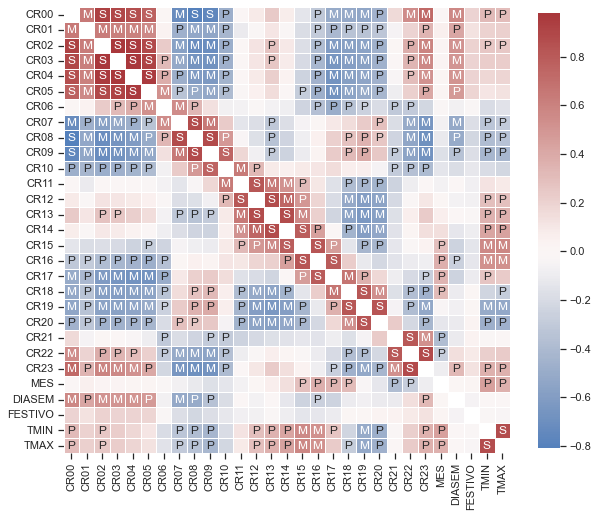

In [72]:
# Computes feature correlation
df_corr = df_aju.corr(method="pearson")

# Create labels for the correlation matrix
labels = np.where(np.abs(df_corr)>0.75, "S",
                  np.where(np.abs(df_corr)>0.5, "M",
                           np.where(np.abs(df_corr)>0.25, "P", "")))

# Plot correlation matrix
plt.figure(figsize=(10, 10))
sns.heatmap(df_corr, mask=np.eye(len(df_corr)), square=True,
            center=0, annot=labels, fmt='', linewidths=.5,
            cmap="vlag", cbar_kws={"shrink": 0.8});


Los gráficos anteriores muestran todas las relaciones entre las variables y frente a la variable de salida Festivo. Destaca la relación lineal que existe entre muchas de las variables sobre todo cuando son horas cosecutivas(también se puede observar que están muy correladas). Las primeras cinco CRs parecen estar muy correladas entre ellas por lo que es posible que aporten la misma información. Además, se comparan las variables que más peso han tenido en los modelos. Es difícil observar cuales pueden ser mejores a la hora de clasificar los días festivos puesto que ninguna parece hacer una distinción muy clara. Esto se debe también al bajo número de la clase positiva con los que contamos.


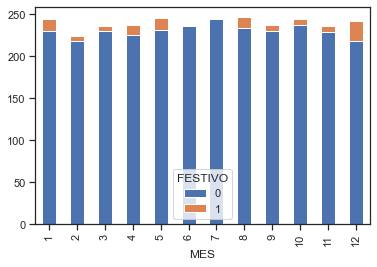

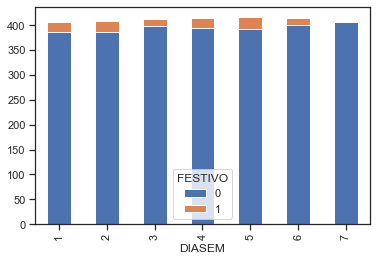

In [73]:
festivos_por_mes = df_aju.groupby(['MES','FESTIVO'])['FESTIVO'].count().unstack()
festivos_por_mes.plot(kind='bar', stacked=True)
plt.show()

festivos_por_dia = df_aju.groupby(['DIASEM','FESTIVO'])['FESTIVO'].count().unstack()
festivos_por_dia.plot(kind='bar', stacked=True)
plt.show()

Los meses que más festivos tienen son Diciembre, Enero y Mayo. Domingo es el día con menos festivos y Viernes y Lunes los días que más son festivos.


#### Prepara los conjuntos de entrenamiento y test

- Divide los datos disponibles de ajuste (df_aju) en dos conjuntos diferentes (TR:80% y TS: 20%). TS lo deberías de utilizar para validar la calidad de los diferentes modelos que se creen.
- Recuerda fijar una semilla para garantizar que la separación es reproducible

In [6]:
#-------------------------- NO ESCRIBAS LÍNEAS DE CÓDIGO MÁS LARGAS QUE LO QUE OCUPA ESTA LÍNEA -----------------------------|
df_aju.FESTIVO = df_aju.FESTIVO.astype('category')
# Crea dos dataframes df_aju_tr y df_aju_ts y trabaja con ellos
# Define input and output matrices
INPUTS = ['CR00', 'CR01', 'CR02', 'CR03', 'CR04', 'CR05', 'CR06', 'CR07',
       'CR08', 'CR09', 'CR10', 'CR11', 'CR12', 'CR13', 'CR14', 'CR15', 'CR16',
       'CR17', 'CR18', 'CR19', 'CR20', 'CR21', 'CR22', 'CR23', 'MES', 'DIASEM', 
       'TMIN', 'TMAX']
OUTPUT = 'FESTIVO'
X = df_aju[INPUTS]
y = df_aju[OUTPUT]

# Split
X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                    test_size=0.2,  #percentage of test data
                                                    random_state=0, #seed for replication
                                                    stratify = y)   #Preserves distribution of y

#### 1.2. Ajusta un modelo de clasificación sencillo que sea robusto y que pueda servir de referencia de comparación con otros modelos más complejos.

- Optimiza la complejidad
- Revisa los errores en TR y TS, la matrices de confusión, y verifica la capacidad de generación
- Analiza la lógica que emplea para determinar si es festivo
- Revisa la importancia de las variables

In [7]:
#-------------------------- NO ESCRIBAS LÍNEAS DE CÓDIGO MÁS LARGAS QUE LO QUE OCUPA ESTA LÍNEA -----------------------------|
## Inputs of the model
INPUTS_DT = INPUTS

# grid in min_impurity x min_samples_leaf x min_samples_split
param = {'DT__min_impurity_decrease': np.arange(0,0.05,0.005), # Minimum entropy to decrease in each split
         'DT__min_samples_leaf': np.arange(1,10,1), # Minimum number of obs in a terminal node
         'DT__min_samples_split':  np.arange(1,10,1)} # Minimum number of obs in node to keep cutting

# param = {'DT__min_impurity_decrease': np.arange(0,0.05,0.005)} # Minimum entropy to decrease in each split

pipe = Pipeline(steps=[('DT', DecisionTreeClassifier(criterion='gini',  # impurity measure
                                                     random_state=150))]) # For replication
                                                     
# We use Grid Search Cross Validation to find the best parameter for the model in the grid defined 
nFolds = 10
tree_fit = GridSearchCV(estimator=pipe, # Structure of the model to use
                       param_grid=param, # Defined grid to search in
                       n_jobs=-1, # Number of cores to use (parallelize)
                       scoring='accuracy', # Accuracy https://scikit-learn.org/stable/modules/model_evaluation.html
                       cv=nFolds) # Number of Folds 
tree_fit.fit(X_train[INPUTS_DT], y_train) # Search in grid

c:\Users\juanm\miniconda3\envs\ml\lib\site-packages\sklearn\model_selection\_validation.py:372: FitFailedWarning: 
900 fits failed out of a total of 8100.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
900 fits failed with the following error:
Traceback (most recent call last):
  File "c:\Users\juanm\miniconda3\envs\ml\lib\site-packages\sklearn\model_selection\_validation.py", line 680, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "c:\Users\juanm\miniconda3\envs\ml\lib\site-packages\sklearn\pipeline.py", line 394, in fit
    self._final_estimator.fit(Xt, y, **fit_params_last_step)
  File "c:\Users\juanm\miniconda3\envs\ml\lib\site-packages\sklearn\tree\_classes.py", line 937, in fit
    super().fit(
  File 

GridSearchCV(cv=10,
             estimator=Pipeline(steps=[('DT',
                                        DecisionTreeClassifier(random_state=150))]),
             n_jobs=-1,
             param_grid={'DT__min_impurity_decrease': array([0.   , 0.005, 0.01 , 0.015, 0.02 , 0.025, 0.03 , 0.035, 0.04 ,
       0.045]),
                         'DT__min_samples_leaf': array([1, 2, 3, 4, 5, 6, 7, 8, 9]),
                         'DT__min_samples_split': array([1, 2, 3, 4, 5, 6, 7, 8, 9])},
             scoring='accuracy')

In [8]:
# Show the best grid parameter combination found by CV
tree_fit.best_estimator_['DT'].get_params()

{'ccp_alpha': 0.0,
 'class_weight': None,
 'criterion': 'gini',
 'max_depth': None,
 'max_features': None,
 'max_leaf_nodes': None,
 'min_impurity_decrease': 0.0,
 'min_samples_leaf': 1,
 'min_samples_split': 9,
 'min_weight_fraction_leaf': 0.0,
 'random_state': 150,
 'splitter': 'best'}

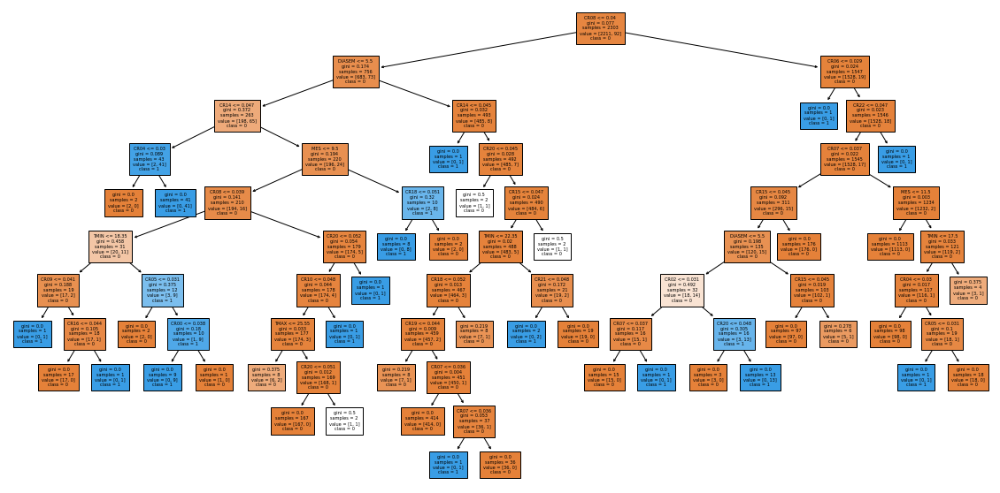

In [9]:
## Plot the decision tree model (use figsize and fontsize for getting the best view)
plt.figure(figsize=(20, 10))
plot_tree(tree_fit.best_estimator_['DT'],
          feature_names= INPUTS_DT,
          class_names= [str(s) for s in y_train.unique()],
          fontsize=5, filled=True)
plt.show()

In [10]:
# Easy reading of the tree
print(export_text(tree_fit.best_estimator_['DT'], feature_names= INPUTS_DT))

|--- CR08 <= 0.04
|   |--- DIASEM <= 5.50
|   |   |--- CR14 <= 0.05
|   |   |   |--- CR04 <= 0.03
|   |   |   |   |--- class: 0
|   |   |   |--- CR04 >  0.03
|   |   |   |   |--- class: 1
|   |   |--- CR14 >  0.05
|   |   |   |--- MES <= 9.50
|   |   |   |   |--- CR08 <= 0.04
|   |   |   |   |   |--- TMIN <= 18.35
|   |   |   |   |   |   |--- CR09 <= 0.04
|   |   |   |   |   |   |   |--- class: 1
|   |   |   |   |   |   |--- CR09 >  0.04
|   |   |   |   |   |   |   |--- CR16 <= 0.04
|   |   |   |   |   |   |   |   |--- class: 0
|   |   |   |   |   |   |   |--- CR16 >  0.04
|   |   |   |   |   |   |   |   |--- class: 1
|   |   |   |   |   |--- TMIN >  18.35
|   |   |   |   |   |   |--- CR05 <= 0.03
|   |   |   |   |   |   |   |--- class: 0
|   |   |   |   |   |   |--- CR05 >  0.03
|   |   |   |   |   |   |   |--- CR00 <= 0.04
|   |   |   |   |   |   |   |   |--- class: 1
|   |   |   |   |   |   |   |--- CR00 >  0.04
|   |   |   |   |   |   |   |   |--- class: 0
|   |   |   |   |--- CR08

In [11]:
# model predictions in training (TR) and test (TS) sets
clf = tree_fit.best_estimator_['DT']
y_train_pred = clf.predict(X_train[INPUTS_DT]).tolist()
y_test_pred = clf.predict(X_test[INPUTS_DT]).tolist()

# main metrics
acc_tr = metrics.accuracy_score(y_train,y_train_pred)
acc_ts = metrics.accuracy_score(y_test,y_test_pred)

acc_bal_tr = metrics.balanced_accuracy_score(y_train,y_train_pred)
acc_bal_ts = metrics.balanced_accuracy_score(y_test,y_test_pred)

dfacc_DT =  pd.DataFrame([[acc_tr, acc_ts], [acc_bal_tr, acc_bal_ts]], index= ['Accuracy', 'Balanced accuracy'],  columns=['TR', 'TS'])
print(dfacc_DT)

print('\nMETRICS TRAINING:')
CT.confusion_matrix(y_train, y_train_pred, labels=[1,0])
print('\nMETRICS TEST SET:')
CT.confusion_matrix(y_test, y_test_pred, labels=[1,0])

                         TR        TS
Accuracy           0.996092  0.967014
Balanced accuracy  0.951087  0.774471

METRICS TRAINING:
Confusion Matrix and Statistics
	   Prediction
 Reference  1    0
         1 83    9
         0  0 2211

Accuracy: 1.0
No Information Rate: 0.93
P-Value [Acc > NIR]: 0.0
Kappa: 0.95
Mcnemar's Test P-Value: 0.0
Sensitivity: 1.0
Specificity: 0.9
Precision: 1.0
Recall: 0.9
Prevalence: 0.96
Detection Rate: 0.96
Detection prevalence: 0.96
Balanced accuracy: 0.95
F1 Score: 0.95
Positive label: 1

METRICS TEST SET:
Confusion Matrix and Statistics
	   Prediction
 Reference  1   0
         1 13  10
         0  9 544

Accuracy: 0.97
No Information Rate: 0.92
P-Value [Acc > NIR]: 0.23
Kappa: 0.56
Mcnemar's Test P-Value: 1.0
Sensitivity: 0.98
Specificity: 0.57
Precision: 0.59
Recall: 0.57
Prevalence: 0.96
Detection Rate: 0.94
Detection prevalence: 0.96
Balanced accuracy: 0.77
F1 Score: 0.58
Positive label: 1


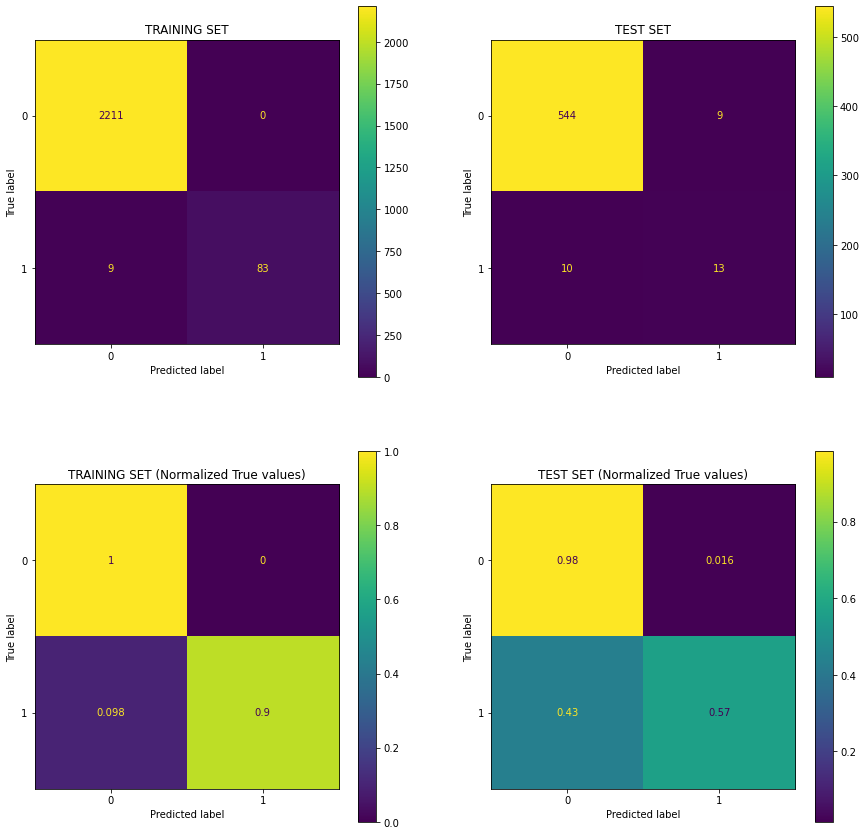

In [12]:
fig = plt.figure(figsize=(15, 15))

ax = plt.subplot(2,2,1)
ConfusionMatrixDisplay.from_estimator(clf, X_train, y_train, ax = ax)
plt.title ('TRAINING SET')

ax = plt.subplot(2,2,2)
ConfusionMatrixDisplay.from_estimator(clf, X_test, y_test, ax = ax)
plt.title ('TEST SET')

ax = plt.subplot(2,2,3)
ConfusionMatrixDisplay.from_estimator(clf, X_train, y_train, ax = ax, normalize = 'true')
plt.title ('TRAINING SET (Normalized True values)')

ax = plt.subplot(2,2,4)
ConfusionMatrixDisplay.from_estimator(clf, X_test, y_test, ax = ax, normalize = 'true')
plt.title ('TEST SET (Normalized True values)')

plt.show()

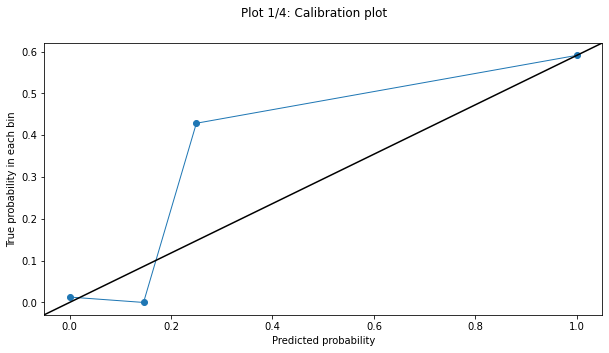

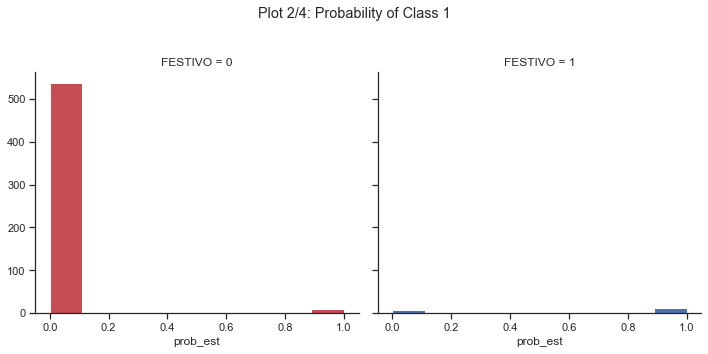

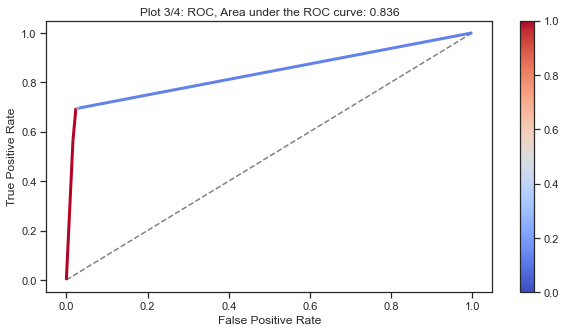

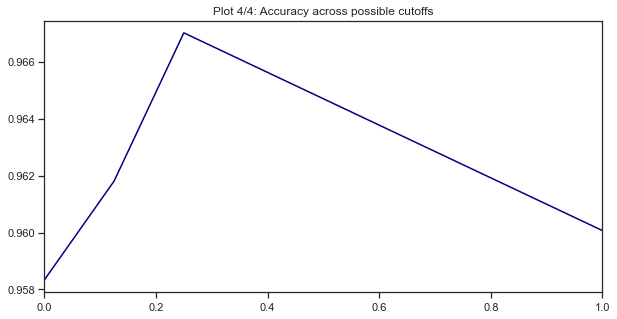

In [13]:
CT.plotClassPerformance(y_test, clf.predict_proba(X_test[INPUTS_DT]), selClass=1)

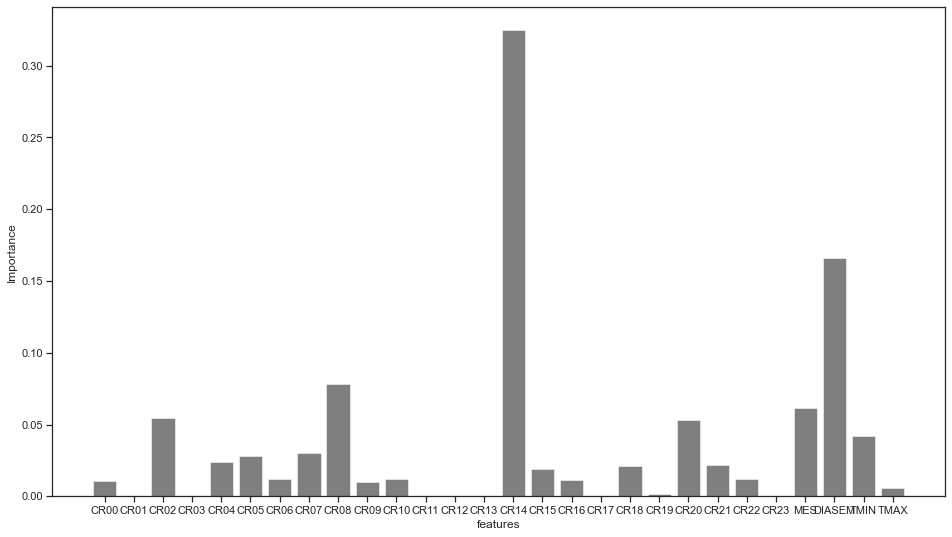

In [14]:
## Plot the variable importance of each feature
plt.figure(figsize=(16, 9))
bar_width = 0.35
plt.bar(INPUTS_DT, tree_fit.best_estimator_['DT'].feature_importances_, color='black', alpha=0.5)
plt.xlabel('features')
plt.ylabel('Importance')
plt.show()

El árbol cuenta con un nivel de pureza de 0, requiere al menos 9 muestras para dividir un nodo y requiere al menos una muestra en cada hoja. Para determinar si es festivo primero se fija en la variable CR8, luego la división se hace según el día de la semana y el CR06. Las variables más importantes son CR14, DIASEM, CR08 CR02 Y CR20.

Guardamos el modelo

In [15]:
with open('./modelos/DT.pickle', 'wb') as f:
    pickle.dump(clf, f)

#### 1.3. Ajusta un bagged tree para resolver el problema planteado.

- Optimiza la complejidad
- Revisa los errores en TR y TS, la matrices de confusión, y verifica la capacidad de generación
- Revisa la importancia de las variables

In [16]:
number_estimators = 50
base_estimator =  Pipeline(steps=[('DT', 
                                    DecisionTreeClassifier( criterion='gini',  # impurity measure
                                                            min_samples_split=2, # Minimum number of obs in node to keep cutting
                                                            min_samples_leaf=1, # Minimum number of obs in a terminal node
                                                            random_state=150))])

bag_class_estim = BaggingClassifier(base_estimator=base_estimator,
                                    n_estimators=number_estimators,
                                    random_state=150)

# fit the bagged trees
INPUTS_BT = INPUTS                 
bag_class_estim.fit(X_train[INPUTS_BT], y_train)

BaggingClassifier(base_estimator=Pipeline(steps=[('DT',
                                                  DecisionTreeClassifier(random_state=150))]),
                  n_estimators=50, random_state=150)

In [17]:
#-------------------------- NO ESCRIBAS LÍNEAS DE CÓDIGO MÁS LARGAS QUE LO QUE OCUPA ESTA LÍNEA -----------------------------|
# find optim nº of trees in the ensemble
param = {'BT__n_estimators': range(20, 150, 5)} # Number of trees to aggregate

pipe =  Pipeline(steps=[('BT', 
                            BaggingClassifier(base_estimator=base_estimator,
                                              random_state=150))])

# We use Grid Search Cross Validation to find the best parameter for the model in the grid defined 
nFolds = 10
bt_fit = GridSearchCV(estimator=pipe, # Structure of the model to use
                       param_grid=param, # Defined grid to search in
                       n_jobs=-1, # Number of cores to use (parallelize)
                       scoring='accuracy', # Accuracy https://scikit-learn.org/stable/modules/model_evaluation.html
                       cv=nFolds) # Number of Folds 
# fit the bagged trees
INPUTS_BT = INPUTS  
bt_fit.fit(X_train[INPUTS_BT], y_train) # Search in grid

GridSearchCV(cv=10,
             estimator=Pipeline(steps=[('BT',
                                        BaggingClassifier(base_estimator=Pipeline(steps=[('DT',
                                                                                          DecisionTreeClassifier(random_state=150))]),
                                                          random_state=150))]),
             n_jobs=-1, param_grid={'BT__n_estimators': range(20, 150, 5)},
             scoring='accuracy')

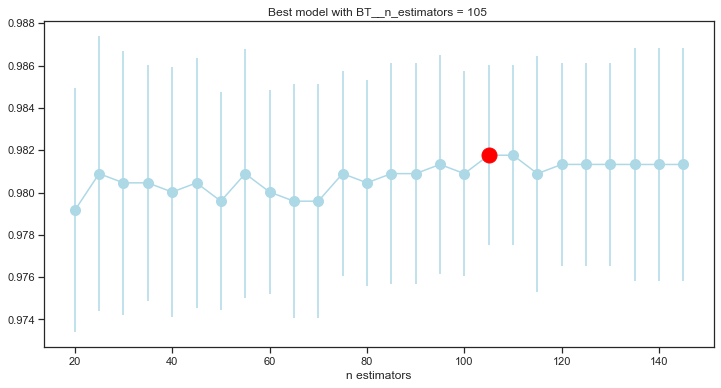

In [18]:
MT.plotModelGridError(bt_fit)

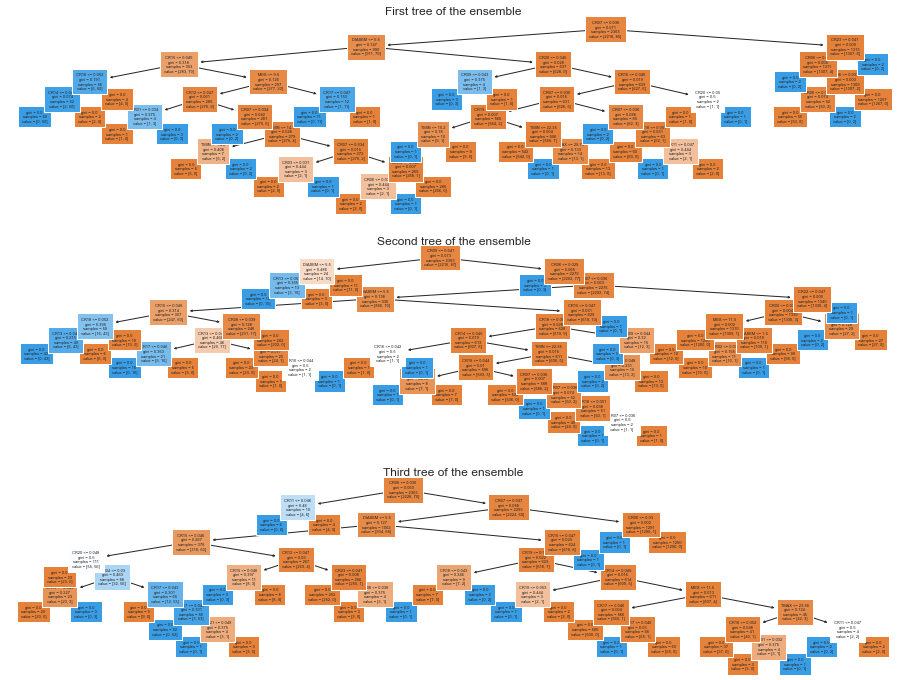

In [19]:
## Plot first trees of the ensemble
plt.figure(figsize=(16, 12))
plt.subplot(3,1,1)
plot_tree(bt_fit.best_estimator_['BT'].estimators_[0]['DT'], feature_names= INPUTS_BT, fontsize=4, filled=True)
plt.title(f'First tree of the ensemble')
plt.subplot(3,1,2)
plot_tree(bt_fit.best_estimator_['BT'].estimators_[1]['DT'], feature_names= INPUTS_BT, fontsize=4, filled=True)
plt.title(f'Second tree of the ensemble')
plt.subplot(3,1,3)
plot_tree(bt_fit.best_estimator_['BT'].estimators_[2]['DT'], feature_names= INPUTS_BT, fontsize=4, filled=True)
plt.title(f'Third tree of the ensemble')
plt.show()

In [20]:
# model predictions in training (TR) and test (TS) sets
clf = bt_fit
y_train_pred = clf.predict(X_train[INPUTS_DT]).tolist()
y_test_pred = clf.predict(X_test[INPUTS_DT]).tolist()

# main metrics
acc_tr = metrics.accuracy_score(y_train,y_train_pred)
acc_ts = metrics.accuracy_score(y_test,y_test_pred)

acc_bal_tr = metrics.balanced_accuracy_score(y_train,y_train_pred)
acc_bal_ts = metrics.balanced_accuracy_score(y_test,y_test_pred)

dfacc_BT =  pd.DataFrame([[acc_tr, acc_ts], [acc_bal_tr, acc_bal_ts]], index= ['Accuracy', 'Balanced accuracy'],  columns=['TR', 'TS'])
print(dfacc_BT)

print('\nMETRICS TRAINING:')
CT.confusion_matrix(y_train, y_train_pred, labels=[1,0])
print('\nMETRICS TEST SET:')
CT.confusion_matrix(y_test, y_test_pred, labels=[1,0])

                    TR        TS
Accuracy           1.0  0.984375
Balanced accuracy  1.0  0.846018

METRICS TRAINING:
Confusion Matrix and Statistics
	   Prediction
 Reference  1    0
         1 92    0
         0  0 2211

Accuracy: 1.0
No Information Rate: 0.92
P-Value [Acc > NIR]: 0.0
Kappa: 1.0
Mcnemar's Test P-Value: 1.0
Sensitivity: 1.0
Specificity: 1.0
Precision: 1.0
Recall: 1.0
Prevalence: 0.96
Detection Rate: 0.96
Detection prevalence: 0.96
Balanced accuracy: 1.0
F1 Score: 1.0
Positive label: 1

METRICS TEST SET:
Confusion Matrix and Statistics
	   Prediction
 Reference  1   0
         1 16   7
         0  2 551

Accuracy: 0.98
No Information Rate: 0.93
P-Value [Acc > NIR]: 0.0
Kappa: 0.77
Mcnemar's Test P-Value: 0.18
Sensitivity: 1.0
Specificity: 0.7
Precision: 0.89
Recall: 0.7
Prevalence: 0.96
Detection Rate: 0.96
Detection prevalence: 0.97
Balanced accuracy: 0.85
F1 Score: 0.78
Positive label: 1


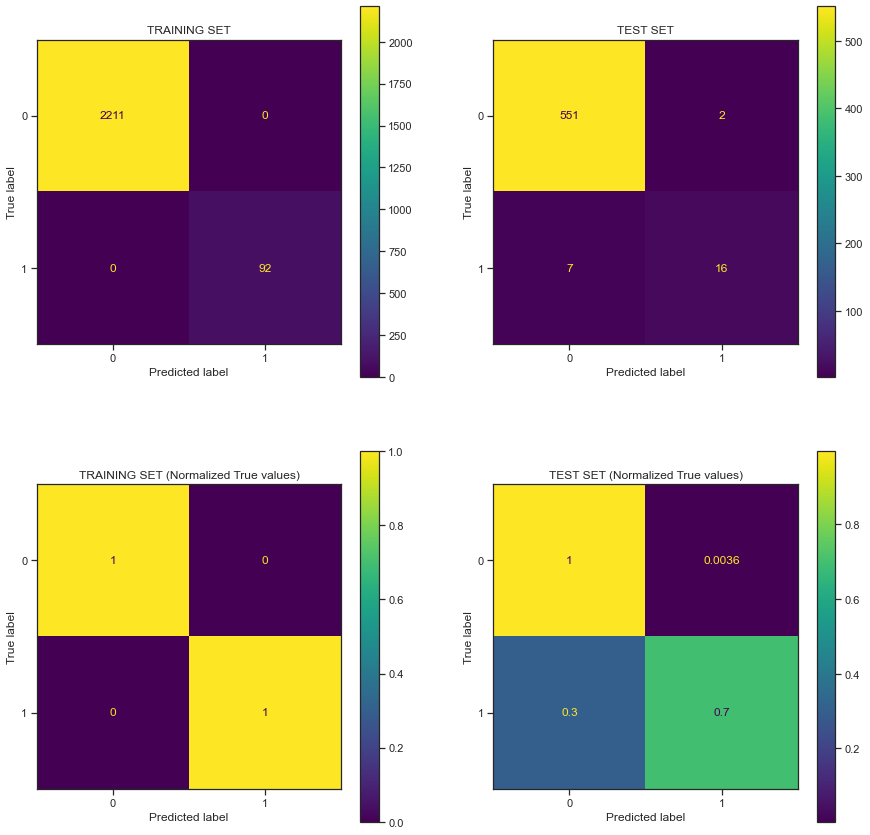

In [21]:
fig = plt.figure(figsize=(15,15))

ax = plt.subplot(2,2,1)
ConfusionMatrixDisplay.from_estimator(clf, X_train, y_train, ax = ax)
plt.title ('TRAINING SET')

ax = plt.subplot(2,2,2)
ConfusionMatrixDisplay.from_estimator(clf, X_test, y_test, ax = ax)
plt.title ('TEST SET')

ax = plt.subplot(2,2,3)
ConfusionMatrixDisplay.from_estimator(clf, X_train, y_train, ax = ax, normalize = 'true')
plt.title ('TRAINING SET (Normalized True values)')

ax = plt.subplot(2,2,4)
ConfusionMatrixDisplay.from_estimator(clf, X_test, y_test, ax = ax, normalize = 'true')
plt.title ('TEST SET (Normalized True values)')

plt.show()

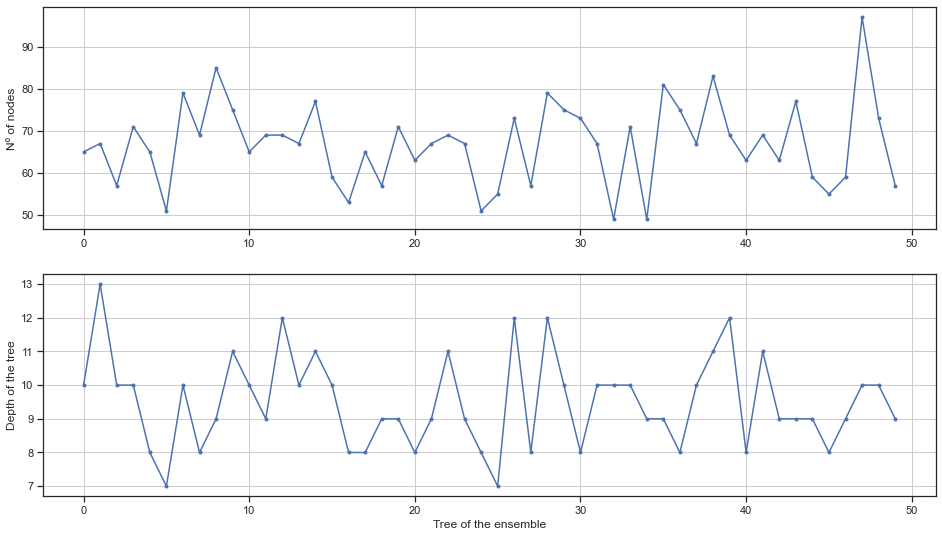

In [22]:
# number of nodes in each tree of the ensemble
node_count_trees = [t['DT'].tree_.node_count for t in bag_class_estim.estimators_]

# number of nodes in each tree of the ensemble
depth_trees = [t['DT'].tree_.max_depth for t in bag_class_estim.estimators_]

fig = plt.figure(1, figsize=(16, 9))
ax1=plt.subplot(2,1,1)
plt.plot(node_count_trees, '.-')
plt.ylabel('Nº of nodes')                       
plt.grid()

plt.subplot(2,1,2, sharex = ax1)
plt.plot(depth_trees, '.-')
plt.ylabel('Depth of the tree')                       
plt.xlabel('Tree of the ensemble')                  
plt.grid()
plt.show()

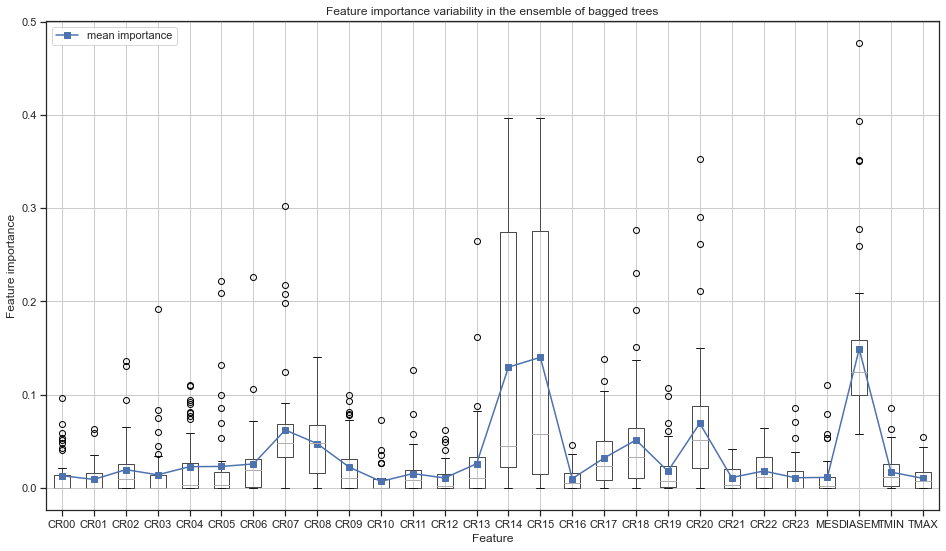

In [23]:
# feature importances of each tree in the ensemble
feature_importances_trees = [t['DT'].feature_importances_ for t in bag_class_estim.estimators_]

# global view of feature importances
dfimp =  pd.DataFrame(list(feature_importances_trees), columns=INPUTS_BT)
dfimp.boxplot(figsize=(16, 9))
plt.plot(np.arange(len(INPUTS_BT))+1, dfimp.mean(),'s-', label ='mean importance')
plt.ylabel('Feature importance') 
plt.xlabel('Feature') 
plt.title('Feature importance variability in the ensemble of bagged trees')
plt.legend()
plt.show()

El modelo óptimo cuenta con 105 estimadores. En este caso las variables más importantes son CR14, CR15, DIASEM, CR20, CR07 Y CR08.

Guardamos el modelo

In [24]:
with open('./modelos/BT.pickle', 'wb') as f:
    pickle.dump(clf, f)

#### 1.4. Ajusta un random forest para resolver el problema planteado.

- Optimiza la complejidad
- Revisa los errores en TR y TS, la matrices de confusión, y verifica la capacidad de generación
- Revisa la importancia de las variables

In [25]:
#-------------------------- NO ESCRIBAS LÍNEAS DE CÓDIGO MÁS LARGAS QUE LO QUE OCUPA ESTA LÍNEA -----------------------------|

# Convert output variable to categorical
df_aju.FESTIVO = df_aju.FESTIVO.astype('category')

In [26]:
#-------------------------- NO ESCRIBAS LÍNEAS DE CÓDIGO MÁS LARGAS QUE LO QUE OCUPA ESTA LÍNEA -----------------------------|

# Define input and output matrices
INPUTS = ['CR00', 'CR01', 'CR02', 'CR03', 'CR04', 'CR05', 'CR06', 'CR07',
       'CR08', 'CR09', 'CR10', 'CR11', 'CR12', 'CR13', 'CR14', 'CR15', 'CR16',
       'CR17', 'CR18', 'CR19', 'CR20', 'CR21', 'CR22', 'CR23', 'MES', 'DIASEM', 
       'TMIN', 'TMAX']
OUTPUT = 'FESTIVO'
X = df_aju[INPUTS]
y = df_aju[OUTPUT]

# Split
X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                    test_size=0.2,  #percentage of test data
                                                    random_state=0, #seed for replication
                                                    stratify = y)   #Preserves distribution of y

#### 1.4.1. Ajustamos Random Forest optimizado utilizando GridSearch

Para optimizar la complejidad del modelo se ha realizado un barrido del número de variables de entrada que se muestran a cada árbol y el número de árboles en el modelo. Por otro lado, el criterio de los árboles se ha escogido con el número limitado de registros con `FESTIVO` = 1 presente.

In [27]:
#-------------------------- NO ESCRIBAS LÍNEAS DE CÓDIGO MÁS LARGAS QUE LO QUE OCUPA ESTA LÍNEA -----------------------------|

# find optim nº of trees in the ensemble and max_features
param = {'RF__max_features': range(1, 6, 1), # Number number of features to consider when looking for the best split
         'RF__n_estimators': range(20, 150, 5)} # Number of trees in the forest

pipe =  Pipeline(steps=[('RF', 
                            RandomForestClassifier(
                                        criterion='gini',  # impurity measure
                                        min_samples_split=2, # Minimum number of obs in node to keep cutting
                                        min_samples_leaf=1, # Minimum number of obs in a terminal node  
                                        random_state=0)
                        )])

# We use Grid Search Cross Validation to find the best parameter for the model in the grid defined 
nFolds = 10
rf_fit = GridSearchCV(estimator=pipe, # Structure of the model to use
                       param_grid=param, # Defined grid to search in
                       n_jobs=-1, # Number of cores to use (parallelize)
                       scoring='accuracy', # Accuracy https://scikit-learn.org/stable/modules/model_evaluation.html
                       cv=nFolds) # Number of Folds 
# fit the bagged trees
INPUTS_RF = INPUTS  
rf_fit.fit(X_train[INPUTS_RF], y_train) # Search in grid

GridSearchCV(cv=10,
             estimator=Pipeline(steps=[('RF',
                                        RandomForestClassifier(random_state=0))]),
             n_jobs=-1,
             param_grid={'RF__max_features': range(1, 6),
                         'RF__n_estimators': range(20, 150, 5)},
             scoring='accuracy')

Veamos la variación de la precisión en función de los parámetros:

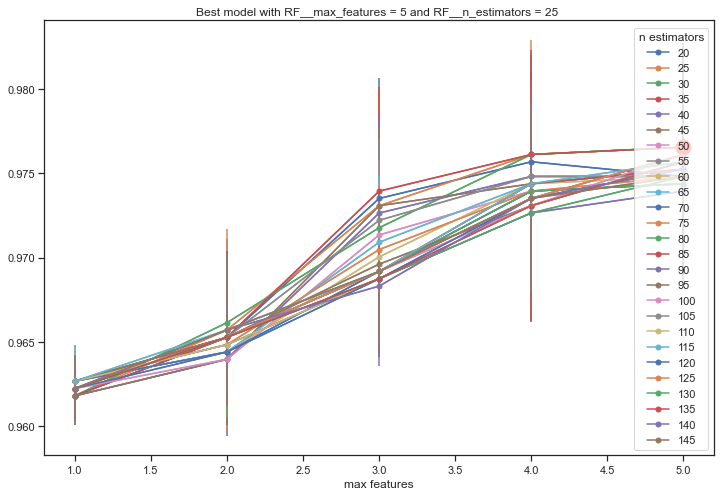

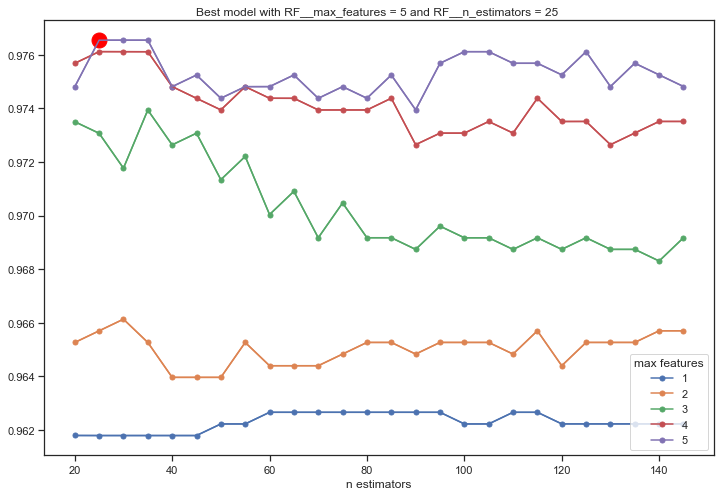

In [28]:
#-------------------------- NO ESCRIBAS LÍNEAS DE CÓDIGO MÁS LARGAS QUE LO QUE OCUPA ESTA LÍNEA -----------------------------|

MT.plotModelGridError(rf_fit)

Hay un modelo que es claramente mejor que el resto y se puede concluir que el modelo seleccionado es adecuado teniendo en cuenta los parámetros considerados.

#### 1.4.2. Analizamos los errores en Train y Test

In [29]:
#-------------------------- NO ESCRIBAS LÍNEAS DE CÓDIGO MÁS LARGAS QUE LO QUE OCUPA ESTA LÍNEA -----------------------------|

# model predictions in training (TR) and test (TS) sets
clf = rf_fit
y_train_pred = clf.predict(X_train[INPUTS_RF]).tolist()
y_test_pred = clf.predict(X_test[INPUTS_RF]).tolist()

# main metrics
acc_tr = metrics.accuracy_score(y_train,y_train_pred)
acc_ts = metrics.accuracy_score(y_test,y_test_pred)

acc_bal_tr = metrics.balanced_accuracy_score(y_train,y_train_pred)
acc_bal_ts = metrics.balanced_accuracy_score(y_test,y_test_pred)

dfacc_RF =  pd.DataFrame([[acc_tr, acc_ts], [acc_bal_tr, acc_bal_ts]], index= ['Accuracy', 'Balanced accuracy'],  
                      columns=['TR', 'TS'])
print(dfacc_RF)

print('\nMETRICS TRAINING:')
CT.confusion_matrix(y_train, y_train_pred, labels=[1,0])
print('\nMETRICS TEST SET:')
CT.confusion_matrix(y_test, y_test_pred, labels=[1,0])

                         TR        TS
Accuracy           0.999566  0.979167
Balanced accuracy  0.994565  0.759965

METRICS TRAINING:
Confusion Matrix and Statistics
	   Prediction
 Reference  1    0
         1 91    1
         0  0 2211

Accuracy: 1.0
No Information Rate: 0.92
P-Value [Acc > NIR]: 0.0
Kappa: 0.99
Mcnemar's Test P-Value: 1.0
Sensitivity: 1.0
Specificity: 0.99
Precision: 1.0
Recall: 0.99
Prevalence: 0.96
Detection Rate: 0.96
Detection prevalence: 0.96
Balanced accuracy: 0.99
F1 Score: 0.99
Positive label: 1

METRICS TEST SET:
Confusion Matrix and Statistics
	   Prediction
 Reference  1   0
         1 12  11
         0  1 552

Accuracy: 0.98
No Information Rate: 0.94
P-Value [Acc > NIR]: 0.01
Kappa: 0.66
Mcnemar's Test P-Value: 0.01
Sensitivity: 1.0
Specificity: 0.52
Precision: 0.92
Recall: 0.52
Prevalence: 0.96
Detection Rate: 0.96
Detection prevalence: 0.98
Balanced accuracy: 0.76
F1 Score: 0.67
Positive label: 1


Los resultados de este modelo son prometedores ya que su precisión balanceada es relativamente alta. Sin embargo, al ver matriz de confusión no parece ser capaz de clasificar correctamente los registos con `FESTIVO` = 1

#### 1.4.3. Analizamos la matriz de confusión

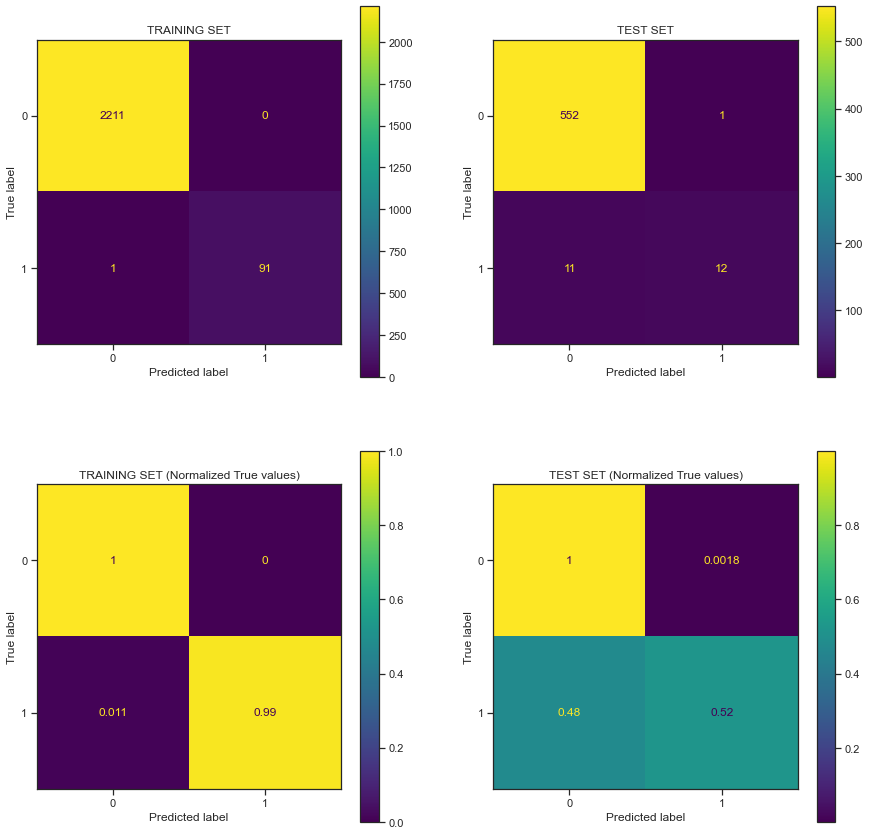

In [30]:
#-------------------------- NO ESCRIBAS LÍNEAS DE CÓDIGO MÁS LARGAS QUE LO QUE OCUPA ESTA LÍNEA -----------------------------|

fig = plt.figure(figsize=(15, 15))

ax = plt.subplot(2,2,1)
ConfusionMatrixDisplay.from_estimator(clf, X_train, y_train, ax = ax)
plt.title ('TRAINING SET')

ax = plt.subplot(2,2,2)
ConfusionMatrixDisplay.from_estimator(clf, X_test, y_test, ax = ax)
plt.title ('TEST SET')

ax = plt.subplot(2,2,3)
ConfusionMatrixDisplay.from_estimator(clf, X_train, y_train, ax = ax, normalize = 'true')
plt.title ('TRAINING SET (Normalized True values)')

ax = plt.subplot(2,2,4)
ConfusionMatrixDisplay.from_estimator(clf, X_test, y_test, ax = ax, normalize = 'true')
plt.title ('TEST SET (Normalized True values)')

plt.show()

#### 1.4.4. Analizamos la importancia de las variables del modelo

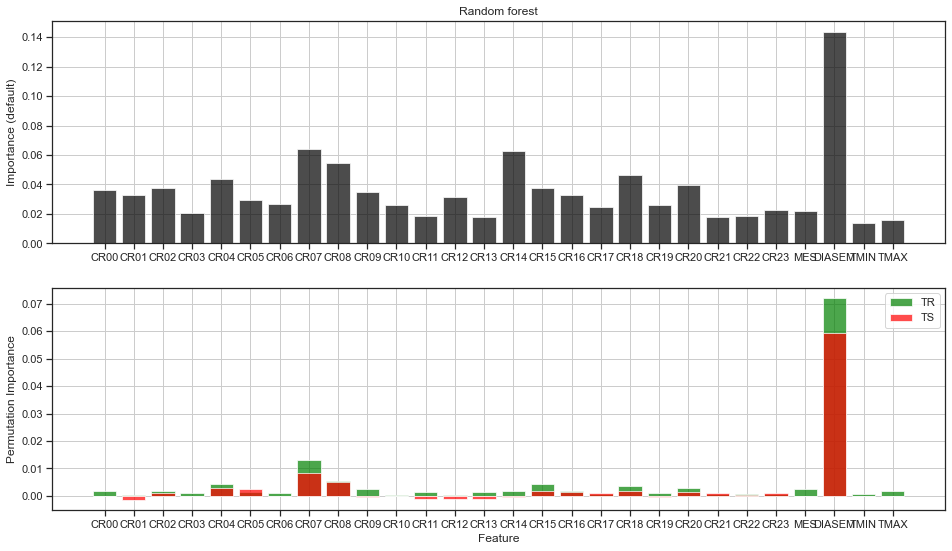

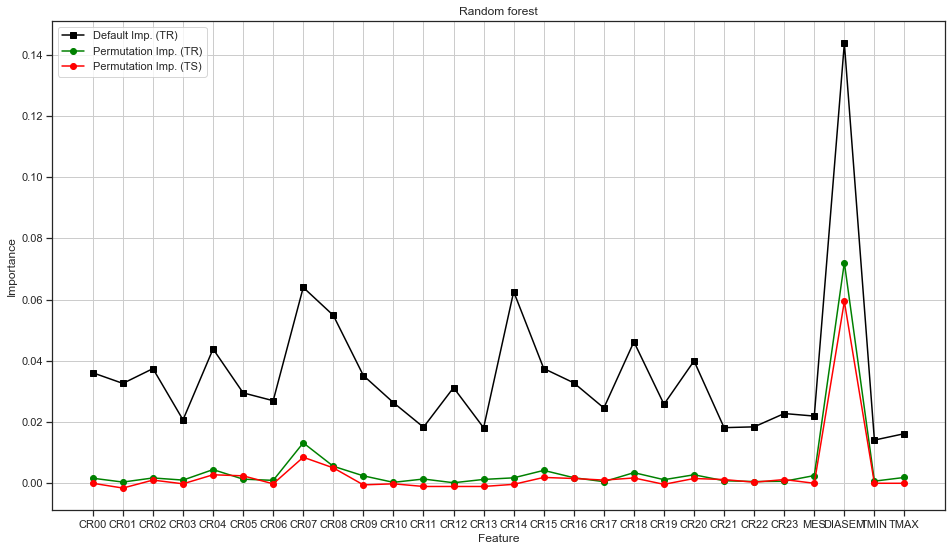

In [31]:
#-------------------------- NO ESCRIBAS LÍNEAS DE CÓDIGO MÁS LARGAS QUE LO QUE OCUPA ESTA LÍNEA -----------------------------|

RF_class_estim = rf_fit.best_estimator_['RF']

## Feature importance evaluation using "Permutation Importance" (training and test)
importances_tr_RF_class_estim = permutation_importance(RF_class_estim, 
                                    X_train[INPUTS_RF], y_train,
                                    n_repeats=10,
                                    random_state=0)

importances_ts_RF_class_estim = permutation_importance(RF_class_estim, 
                                    X_test[INPUTS_RF], y_test,
                                    n_repeats=10,
                                    random_state=0)
 
## Plot importances

# Plot the variable importance of each feature given by feature_importances_ attribute
plt.figure(figsize=(16, 9))

plt.subplot(2,1,1)
plt.bar(INPUTS_RF, RF_class_estim.feature_importances_, color='black', alpha=0.7)
plt.ylabel('Importance (default)')
plt.title('Random forest')
plt.grid()

plt.subplot(2,1,2)
plt.bar(INPUTS_RF, importances_tr_RF_class_estim.importances_mean, color='green', alpha=0.7, label='TR')
plt.bar(INPUTS_RF, importances_ts_RF_class_estim.importances_mean, color='red', alpha=0.7, label='TS')
plt.xlabel('Feature')
plt.ylabel('Permutation Importance')
plt.legend()
plt.grid()
plt.show()

# Plot the variable importances of each feature (all together)
plt.figure(figsize=(16, 9))

plt.plot(INPUTS_RF, RF_class_estim.feature_importances_, 's-',  color='black', label='Default Imp. (TR)')
plt.plot(INPUTS_RF, importances_tr_RF_class_estim.importances_mean, 'o-', color='green', label='Permutation Imp. (TR)')
plt.plot(INPUTS_RF, importances_ts_RF_class_estim.importances_mean, 'o-', color='red', label='Permutation Imp. (TS)')
plt.xlabel('Feature')
plt.ylabel('Importance')
plt.title('Random forest')
plt.legend()
plt.grid()
plt.show()

Las variables de salida de este modelo concuerdan con los resultados obtenidos por los modelos anteriores, al menos para `DIASEM`. Por otro lado, no parece darle mucha importancia a las variables $\{C00,..., C23\}$

Guardamos el modelo

In [32]:
with open('./modelos/RF.pickle', 'wb') as f:
    pickle.dump(RF_class_estim, f)

#### 1.5. Ajusta un gradient boosting para resolver el problema planteado.

- Optimiza la complejidad
- Revisa los errores en TR y TS, la matrices de confusión, y verifica la capacidad de generación
- Revisa la importancia de las variables

#### 1.5.1. Ajustamos Gradient Boosting optimizado utilizando GridSearch

De manera similar que para el Random Forest, se ha realizado un barrido para optimizar la complejidad del modelo:

In [33]:
#-------------------------- NO ESCRIBAS LÍNEAS DE CÓDIGO MÁS LARGAS QUE LO QUE OCUPA ESTA LÍNEA -----------------------------|

# Define the pipeline structure with GradientBoostingClassifier model
pipe = Pipeline([('GB', GradientBoostingClassifier(random_state=150))])

# Define the hyperparameters to evaluate
param_grid = {'GB__n_estimators': [100, 500, 1000],   # Number of trees in the forest
              'GB__learning_rate': [0.01, 0.1, 1],    # Learning rate (shrinkage)
              'GB__max_depth': [1, 2, 3],             # Maximum depth of the individual regression estimators
              'GB__max_features': ['sqrt', 'log2'],   # Number of features to consider when looking for the best split
              'GB__loss': ['log_loss', 'exponential'] # Loss function to be optimized
             }

# Define the GridSearchCV object
gb_fit = GridSearchCV(estimator=pipe, # Model structure to use
                           param_grid=param_grid, # Defined grid to search in
                           cv=10, # Number of cross-validation folds
                           scoring='accuracy', # Scoring metric
                           n_jobs=-1 # Number of parallel jobs to run. -1 means using all processors.
                          )

# Fit the GridSearchCV object to the data
gb_fit.fit(X_train, y_train)

# Print the best hyperparameters and the corresponding score
print("Best Hyperparameters:", gb_fit.best_params_)
print("Best Score:", gb_fit.best_score_)

c:\Users\juanm\miniconda3\envs\ml\lib\site-packages\sklearn\model_selection\_validation.py:372: FitFailedWarning: 
540 fits failed out of a total of 1080.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
540 fits failed with the following error:
Traceback (most recent call last):
  File "c:\Users\juanm\miniconda3\envs\ml\lib\site-packages\sklearn\model_selection\_validation.py", line 680, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "c:\Users\juanm\miniconda3\envs\ml\lib\site-packages\sklearn\pipeline.py", line 394, in fit
    self._final_estimator.fit(Xt, y, **fit_params_last_step)
  File "c:\Users\juanm\miniconda3\envs\ml\lib\site-packages\sklearn\ensemble\_gb.py", line 525, in fit
    self._check_params()


Best Hyperparameters: {'GB__learning_rate': 0.1, 'GB__loss': 'exponential', 'GB__max_depth': 3, 'GB__max_features': 'log2', 'GB__n_estimators': 1000}
Best Score: 0.9869715791454923


In [34]:
#-------------------------- NO ESCRIBAS LÍNEAS DE CÓDIGO MÁS LARGAS QUE LO QUE OCUPA ESTA LÍNEA -----------------------------|

GB_class_estim = gb_fit.best_estimator_['GB']

In [35]:
#-------------------------- NO ESCRIBAS LÍNEAS DE CÓDIGO MÁS LARGAS QUE LO QUE OCUPA ESTA LÍNEA -----------------------------|

# fit
INPUTS_GB = INPUTS                
GB_class_estim.fit(X_train[INPUTS_GB], y_train)

GradientBoostingClassifier(loss='exponential', max_features='log2',
                           n_estimators=1000, random_state=150)

#### 1.5.2. Analizamos los errores en Train y Test

In [36]:
#-------------------------- NO ESCRIBAS LÍNEAS DE CÓDIGO MÁS LARGAS QUE LO QUE OCUPA ESTA LÍNEA -----------------------------|

# model predictions in training (TR) and test (TS) sets
clf = GB_class_estim
y_train_pred = clf.predict(X_train[INPUTS_GB]).tolist()
y_test_pred = clf.predict(X_test[INPUTS_GB]).tolist()

# main metrics
acc_tr = metrics.accuracy_score(y_train,y_train_pred)
acc_ts = metrics.accuracy_score(y_test,y_test_pred)

acc_bal_tr = metrics.balanced_accuracy_score(y_train,y_train_pred)
acc_bal_ts = metrics.balanced_accuracy_score(y_test,y_test_pred)

dfacc_GB =  pd.DataFrame([[acc_tr, acc_ts], [acc_bal_tr, acc_bal_ts]], index= ['Accuracy', 'Balanced accuracy'],  
                      columns=['TR', 'TS'])
print(dfacc_GB)

print('\nMETRICS TRAINING:')
CT.confusion_matrix(y_train, y_train_pred, labels=[1,0])
print('\nMETRICS TEST SET:')
CT.confusion_matrix(y_test, y_test_pred, labels=[1,0])

                    TR        TS
Accuracy           1.0  0.984375
Balanced accuracy  1.0  0.846018

METRICS TRAINING:
Confusion Matrix and Statistics
	   Prediction
 Reference  1    0
         1 92    0
         0  0 2211

Accuracy: 1.0
No Information Rate: 0.92
P-Value [Acc > NIR]: 0.0
Kappa: 1.0
Mcnemar's Test P-Value: 1.0
Sensitivity: 1.0
Specificity: 1.0
Precision: 1.0
Recall: 1.0
Prevalence: 0.96
Detection Rate: 0.96
Detection prevalence: 0.96
Balanced accuracy: 1.0
F1 Score: 1.0
Positive label: 1

METRICS TEST SET:
Confusion Matrix and Statistics
	   Prediction
 Reference  1   0
         1 16   7
         0  2 551

Accuracy: 0.98
No Information Rate: 0.93
P-Value [Acc > NIR]: 0.0
Kappa: 0.77
Mcnemar's Test P-Value: 0.18
Sensitivity: 1.0
Specificity: 0.7
Precision: 0.89
Recall: 0.7
Prevalence: 0.96
Detection Rate: 0.96
Detection prevalence: 0.97
Balanced accuracy: 0.85
F1 Score: 0.78
Positive label: 1


Comparado con el modelo anterior este obtiene resultados aún mejores, con mayor precisión y una matriz de confusión más prometedora.

#### 1.5.3. Analizamos la matriz de confusión

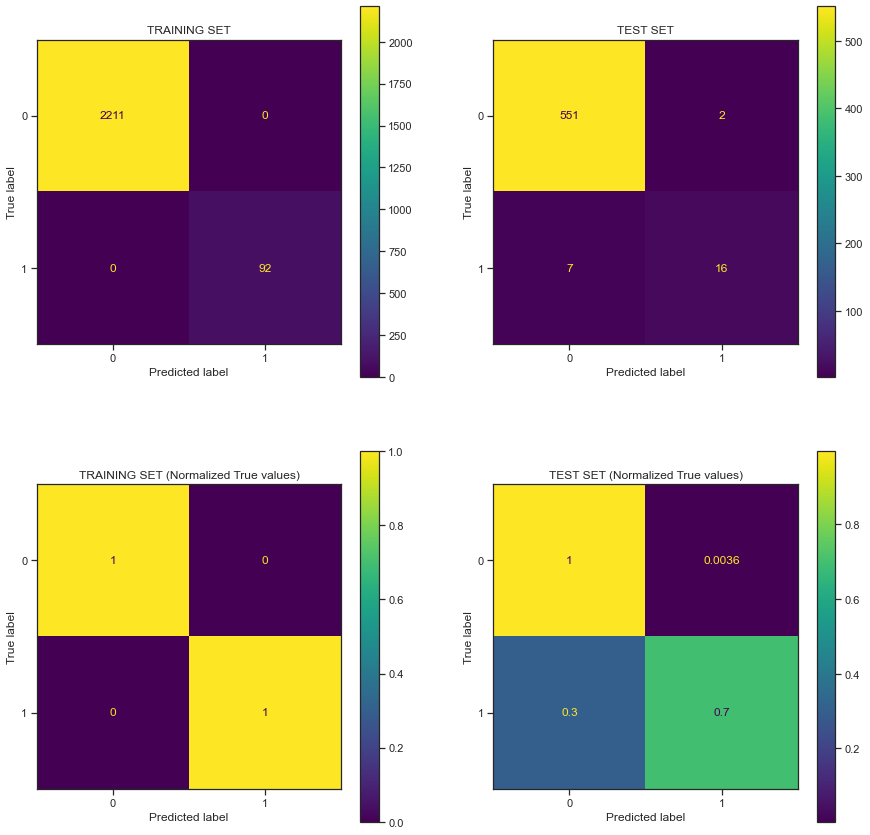

In [37]:
#-------------------------- NO ESCRIBAS LÍNEAS DE CÓDIGO MÁS LARGAS QUE LO QUE OCUPA ESTA LÍNEA -----------------------------|

fig = plt.figure(figsize=(15, 15))

ax = plt.subplot(2,2,1)
ConfusionMatrixDisplay.from_estimator(clf, X_train, y_train, ax = ax)
plt.title ('TRAINING SET')

ax = plt.subplot(2,2,2)
ConfusionMatrixDisplay.from_estimator(clf, X_test, y_test, ax = ax)
plt.title ('TEST SET')

ax = plt.subplot(2,2,3)
ConfusionMatrixDisplay.from_estimator(clf, X_train, y_train, ax = ax, normalize = 'true')
plt.title ('TRAINING SET (Normalized True values)')

ax = plt.subplot(2,2,4)
ConfusionMatrixDisplay.from_estimator(clf, X_test, y_test, ax = ax, normalize = 'true')
plt.title ('TEST SET (Normalized True values)')

plt.show()

#### 1.5.4. Analizamos la importancia de las variables del modelo

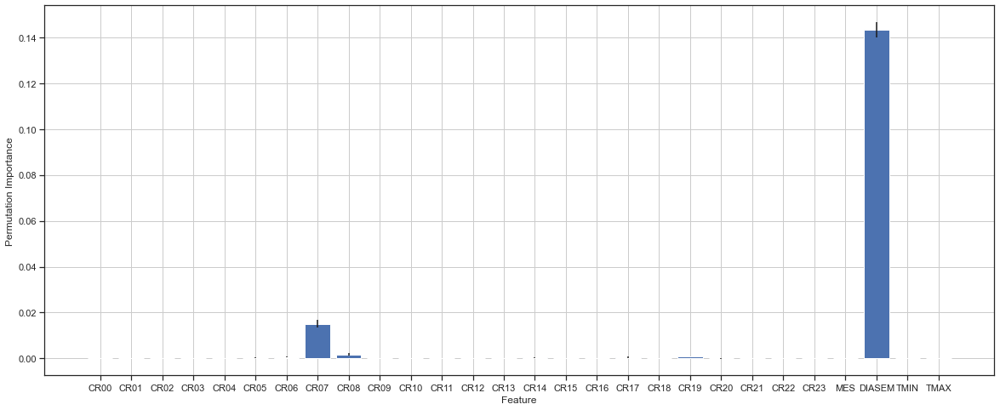

In [38]:
#-------------------------- NO ESCRIBAS LÍNEAS DE CÓDIGO MÁS LARGAS QUE LO QUE OCUPA ESTA LÍNEA -----------------------------|

importances_bag_class_estim = permutation_importance(GB_class_estim, 
                                    X_train[INPUTS_GB], y_train,
                                    n_repeats=10,
                                    random_state=0)

fig = plt.figure(2, figsize=(20,8)) 
plt.bar(INPUTS_GB, importances_bag_class_estim.importances_mean, yerr=importances_bag_class_estim.importances_std)
plt.xlabel('Feature')
plt.ylabel('Permutation Importance')
plt.grid()
plt.show()

Siguiendo la tendencia enterior, la variable `DIASEM` está en las más importantes de todas y, en este caso, la única que tiene más importancia es `CR07`.

Guardamos el modelo

In [39]:
with open('./modelos/GB.pickle', 'wb') as f:
    pickle.dump(GB_class_estim, f)

#### 1.6. Utiliza staking con tus mejores tres modelos para intentar mejorar la soluciones obtenidas.
- Revisa los errores en TR y TS, la matrices de confusión, y verifica la capacidad de generación

Antes hemos guardado los parámetros de cada uno de los modelos, ahora los cargamos para poder realizar el modelo de Stacking

In [40]:
dt_load = pickle.load(open('./modelos/DT.pickle', 'rb'))
gb_load = pickle.load(open('./modelos/GB.pickle', 'rb'))
bt_load = pickle.load(open('./modelos/BT.pickle', 'rb'))

Como estimadores del modelo de Stacking vamos a utilizar el modelo de Gradient Boosting, Bagging Tree y Decision Tree. Hemos seleccionado estos modelos ya que son los que mejores resultados nos han dado

In [41]:
#-------------------------- NO ESCRIBAS LÍNEAS DE CÓDIGO MÁS LARGAS QUE LO QUE OCUPA ESTA LÍNEA -----------------------------|

## set of estimators to be stacked
estimators = [
    ('gradboost', gb_load
    ),
    ('bagtree', bt_load
    ),
    ('clatree', dt_load
    )
]

estimators

[('gradboost',
  GradientBoostingClassifier(loss='exponential', max_features='log2',
                             n_estimators=1000, random_state=150)),
 ('bagtree',
  GridSearchCV(cv=10,
               estimator=Pipeline(steps=[('BT',
                                          BaggingClassifier(base_estimator=Pipeline(steps=[('DT',
                                                                                            DecisionTreeClassifier(random_state=150))]),
                                                            random_state=150))]),
               n_jobs=-1, param_grid={'BT__n_estimators': range(20, 150, 5)},
               scoring='accuracy')),
 ('clatree', DecisionTreeClassifier(min_samples_split=9, random_state=150))]

A cada uno de los estimadores le asociamos el mismo peso ~33%

In [42]:
weights = [0.34, 0.33, 0.33] # pesos de los 3 modelos
stacked_cla = VotingClassifier(estimators = estimators, weights = weights)
stacked_cla = stacked_cla.fit(X_train, y_train)
stacked_cla.get_params()

{'estimators': [('gradboost',
   GradientBoostingClassifier(loss='exponential', max_features='log2',
                              n_estimators=1000, random_state=150)),
  ('bagtree',
   GridSearchCV(cv=10,
                estimator=Pipeline(steps=[('BT',
                                           BaggingClassifier(base_estimator=Pipeline(steps=[('DT',
                                                                                             DecisionTreeClassifier(random_state=150))]),
                                                             random_state=150))]),
                n_jobs=-1, param_grid={'BT__n_estimators': range(20, 150, 5)},
                scoring='accuracy')),
  ('clatree', DecisionTreeClassifier(min_samples_split=9, random_state=150))],
 'flatten_transform': True,
 'n_jobs': None,
 'verbose': False,
 'voting': 'hard',
 'weights': [0.34, 0.33, 0.33],
 'gradboost': GradientBoostingClassifier(loss='exponential', max_features='log2',
                            n_e

- Errores en train y test

Realizamos la predicción y comprobamos los errores

In [43]:
#-------------------------- NO ESCRIBAS LÍNEAS DE CÓDIGO MÁS LARGAS QUE LO QUE OCUPA ESTA LÍNEA -----------------------------|

# model predictions in training (TR) and test (TS) sets
y_train_stack = stacked_cla.predict(X_train)
y_test_stack = stacked_cla.predict(X_test)

# main metrics
acc_tr = metrics.accuracy_score(y_train,y_train_stack)
acc_ts = metrics.accuracy_score(y_test,y_test_stack)

acc_bal_tr = metrics.balanced_accuracy_score(y_train,y_train_stack)
acc_bal_ts = metrics.balanced_accuracy_score(y_test,y_test_stack)

dfacc_ST =  pd.DataFrame([[acc_tr, acc_ts], [acc_bal_tr, acc_bal_ts]], index= ['Accuracy', 'Balanced accuracy'],  
                      columns=['TR', 'TS'])
print(dfacc_ST)

print('\nMETRICS TRAINING:')
CT.confusion_matrix(y_train, y_train_stack, labels=[1,0])
print('\nMETRICS TEST SET:')
CT.confusion_matrix(y_test, y_test_stack, labels=[1,0])

                    TR        TS
Accuracy           1.0  0.984375
Balanced accuracy  1.0  0.846018

METRICS TRAINING:
Confusion Matrix and Statistics
	   Prediction
 Reference  1    0
         1 92    0
         0  0 2211

Accuracy: 1.0
No Information Rate: 0.92
P-Value [Acc > NIR]: 0.0
Kappa: 1.0
Mcnemar's Test P-Value: 1.0
Sensitivity: 1.0
Specificity: 1.0
Precision: 1.0
Recall: 1.0
Prevalence: 0.96
Detection Rate: 0.96
Detection prevalence: 0.96
Balanced accuracy: 1.0
F1 Score: 1.0
Positive label: 1

METRICS TEST SET:
Confusion Matrix and Statistics
	   Prediction
 Reference  1   0
         1 16   7
         0  2 551

Accuracy: 0.98
No Information Rate: 0.93
P-Value [Acc > NIR]: 0.0
Kappa: 0.77
Mcnemar's Test P-Value: 0.18
Sensitivity: 1.0
Specificity: 0.7
Precision: 0.89
Recall: 0.7
Prevalence: 0.96
Detection Rate: 0.96
Detection prevalence: 0.97
Balanced accuracy: 0.85
F1 Score: 0.78
Positive label: 1


Podemos observar como los resultados obtenidos son bastante buenos, obteniendo un accuracy en test del 98,34%. Además, observamos como la diferencia entre el accuracy obtenido en train y test es muy baja. 

- Matrices de confusión

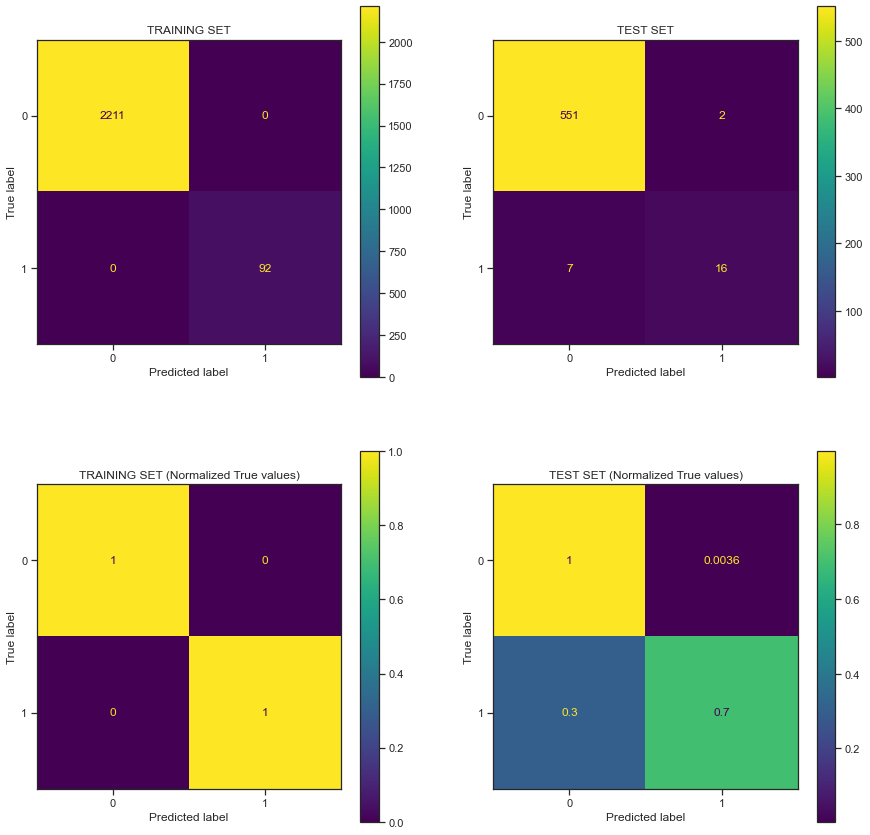

In [44]:
#-------------------------- NO ESCRIBAS LÍNEAS DE CÓDIGO MÁS LARGAS QUE LO QUE OCUPA ESTA LÍNEA -----------------------------|

fig = plt.figure(figsize=(15, 15))

ax = plt.subplot(2,2,1)
ConfusionMatrixDisplay.from_estimator(stacked_cla, X_train, y_train, ax = ax)
plt.title ('TRAINING SET')

ax = plt.subplot(2,2,2)
ConfusionMatrixDisplay.from_estimator(stacked_cla, X_test, y_test, ax = ax)
plt.title ('TEST SET')

ax = plt.subplot(2,2,3)
ConfusionMatrixDisplay.from_estimator(stacked_cla, X_train, y_train, ax = ax, normalize = 'true')
plt.title ('TRAINING SET (Normalized True values)')

ax = plt.subplot(2,2,4)
ConfusionMatrixDisplay.from_estimator(stacked_cla, X_test, y_test, ax = ax, normalize = 'true')
plt.title ('TEST SET (Normalized True values)')

plt.show()

- Capacidad de generalización

Para este caso, el modelo utilizado va a ser un Random Forest con 20 árboles. Para este caso, lo que estamos haciendo es utilizar las salidas de los otros 3 modelos como entradas de un nuevo modelo, en este caso Random Forest, y así, podemos observar la capacidad de generalización del modelo. 

In [45]:
# we use the same set of models to be stacked

stacked_genreg = StackingClassifier(
    estimators = estimators,
    final_estimator=RandomForestClassifier(n_estimators=20, random_state=999)
)

stacked_genreg = stacked_genreg.fit(X_train, y_train)
stacked_genreg

StackingClassifier(estimators=[('gradboost',
                                GradientBoostingClassifier(loss='exponential',
                                                           max_features='log2',
                                                           n_estimators=1000,
                                                           random_state=150)),
                               ('bagtree',
                                GridSearchCV(cv=10,
                                             estimator=Pipeline(steps=[('BT',
                                                                        BaggingClassifier(base_estimator=Pipeline(steps=[('DT',
                                                                                                                          DecisionTreeClassifier(random_state=150))]),
                                                                                          random_state=150))]),
                                             n_jobs=-1,
   

In [74]:
#-------------------------- NO ESCRIBAS LÍNEAS DE CÓDIGO MÁS LARGAS QUE LO QUE OCUPA ESTA LÍNEA -----------------------------|

# model predictions in training (TR) and test (TS) sets
y_train_stack = stacked_genreg.predict(X_train)
y_test_stack = stacked_genreg.predict(X_test)

# main metrics
acc_tr = metrics.accuracy_score(y_train,y_train_stack)
acc_ts = metrics.accuracy_score(y_test,y_test_stack)

acc_bal_tr = metrics.balanced_accuracy_score(y_train,y_train_stack)
acc_bal_ts = metrics.balanced_accuracy_score(y_test,y_test_stack)

dfacc =  pd.DataFrame([[acc_tr, acc_ts], [acc_bal_tr, acc_bal_ts]], index= ['Accuracy', 'Balanced accuracy'],  
                      columns=['TR', 'TS'])
print(dfacc)

print('\nMETRICS TRAINING:')
CT.confusion_matrix(y_train, y_train_stack, labels=[1,0])
print('\nMETRICS TEST SET:')
CT.confusion_matrix(y_test, y_test_stack, labels=[1,0])

                    TR        TS
Accuracy           1.0  0.986111
Balanced accuracy  1.0  0.867757

METRICS TRAINING:
Confusion Matrix and Statistics
	   Prediction
 Reference  1    0
         1 92    0
         0  0 2211

Accuracy: 1.0
No Information Rate: 0.92
P-Value [Acc > NIR]: 0.0
Kappa: 1.0
Mcnemar's Test P-Value: 1.0
Sensitivity: 1.0
Specificity: 1.0
Precision: 1.0
Recall: 1.0
Prevalence: 0.96
Detection Rate: 0.96
Detection prevalence: 0.96
Balanced accuracy: 1.0
F1 Score: 1.0
Positive label: 1

METRICS TEST SET:
Confusion Matrix and Statistics
	   Prediction
 Reference  1   0
         1 17   6
         0  2 551

Accuracy: 0.99
No Information Rate: 0.93
P-Value [Acc > NIR]: 0.0
Kappa: 0.8
Mcnemar's Test P-Value: 0.29
Sensitivity: 1.0
Specificity: 0.74
Precision: 0.89
Recall: 0.74
Prevalence: 0.96
Detection Rate: 0.96
Detection prevalence: 0.97
Balanced accuracy: 0.87
F1 Score: 0.81
Positive label: 1


Podemos observar como practicamente no hay ninguna diferencia entre los valores obtenidos con elñ modelo stacked generalization y el modelo de votation son practicamente nulas.

#### 1.7. Crea un número de variables reducido que contengan la información recogida en las variables CR00 a CR23 y crea un árbol sencillo basado en estas variables.
- El conjunto de variables creado tienen que ser una combinación lineal de CR00, ..., CR23
- Optimiza la complejidad del árbol
- Revisa los errores en TR y TS, la matrices de confusión, y verifica la capacidad de generación
- Analiza la lógica que emplea para determinar si es festivo
- Revisa la importancia de las variables, explicando el significado físico de las variables más importantes
- Compara los errores en TR y TS y la lógica del modelo con el creado anteriormente en el apartado 1.2.


Para empezar, es necesario crear las variables que se van a utilizar para el modelo de árbol sencillo. Para ello se usa el análisis de componentes principales y en primer lugar es necesario hacer un escalado de las varaibles de entrada ya que, si no, la importancia de estas se ve modificada. Después se puede representar gráficamente los parámetros de los primeros 3 componentes principales.

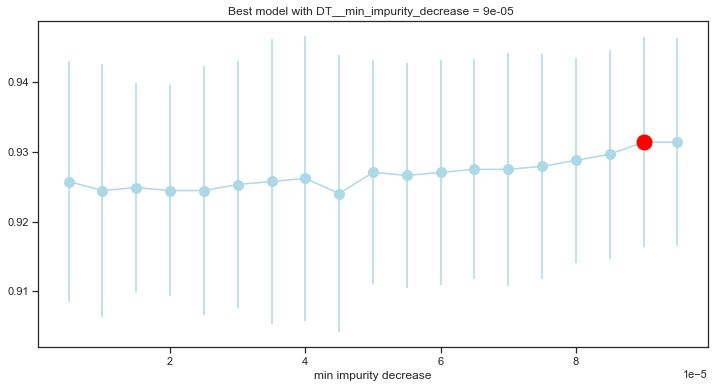

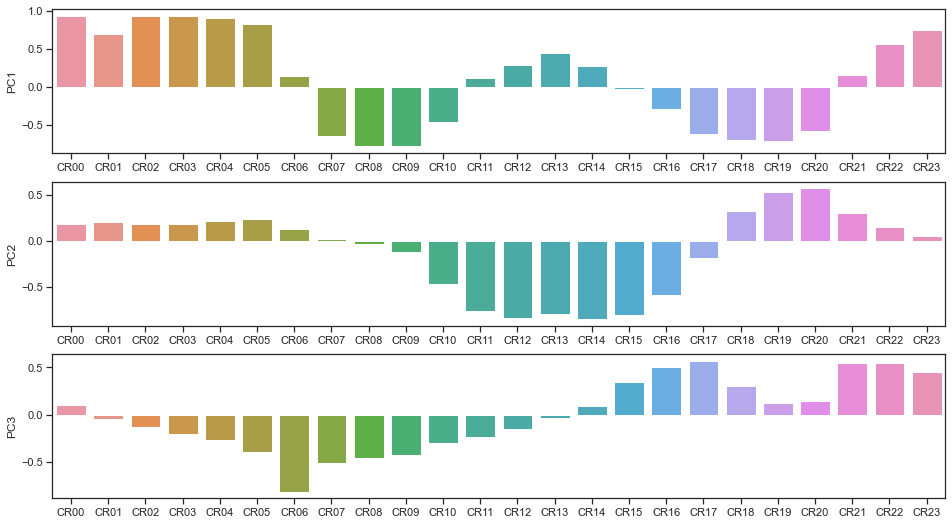

In [47]:
#-------------------------- NO ESCRIBAS LÍNEAS DE CÓDIGO MÁS LARGAS QUE LO QUE OCUPA ESTA LÍNEA -----------------------------|

INPUTS_PCA = ['CR00', 'CR01', 'CR02', 'CR03', 'CR04', 'CR05', 'CR06', 'CR07',
       'CR08', 'CR09', 'CR10', 'CR11', 'CR12', 'CR13', 'CR14', 'CR15', 'CR16',
       'CR17', 'CR18', 'CR19', 'CR20', 'CR21', 'CR22', 'CR23']

numeric_transformer = Pipeline(steps=[('scaler', StandardScaler())])

# Create a preprocessor to perform the steps defined above
preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, INPUTS_PCA),
        ])
    
param = {
        'DT__min_impurity_decrease': np.arange(0.000005, 0.0001, 0.000005)
         } 
PCA_n_components = 3
pipe = Pipeline([
            ('preprocessor', preprocessor),
            ('pca', PCA(n_components = PCA_n_components)),
            ('DT', DecisionTreeClassifier(random_state=150))
        ])

nFolds = 10
PCR_fit = GridSearchCV(estimator=pipe, 
                       param_grid=param,
                       n_jobs=-1, 
                       scoring='accuracy',

                       cv=nFolds) 
PCR_fit.fit(X_train[INPUTS_PCA], y_train, ) 

MT.plotModelGridError(PCR_fit)

# Print the PCs
loadings = pd.DataFrame(
    PCR_fit.best_estimator_[1].components_.T * np.sqrt(PCR_fit.best_estimator_[1].explained_variance_), 
    columns=['PC' + str(pca + 1) for pca in range(PCA_n_components)], 
    index=INPUTS_PCA)


# Plot the 3 first PCs
# fig, axes = plt.subplots(loadings.shape[1], 1, figsize=(16,9))
fig, axes = plt.subplots(3, 1, figsize=(16,9))
PC = 0
for ax in axes.ravel():
    sns.barplot(data=loadings, x=loadings.index, y=loadings.columns.values.tolist()[PC], ax=ax)
    PC += 1

También se puede hacer una representación gráfica de los datos usando las dos primeras componentes como variables:

c:\Users\juanm\miniconda3\envs\ml\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


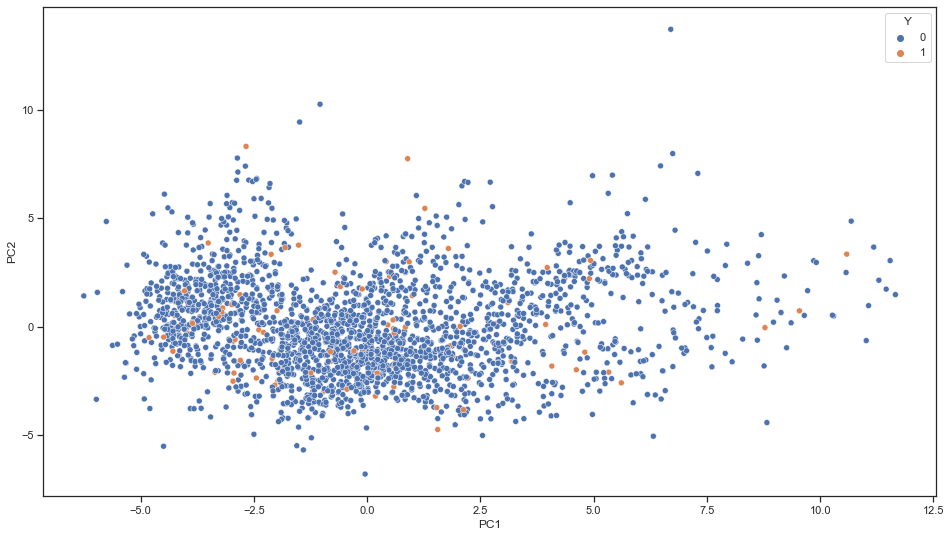

In [48]:

#-------------------------- NO ESCRIBAS LÍNEAS DE CÓDIGO MÁS LARGAS QUE LO QUE OCUPA ESTA LÍNEA -----------------------------|
scaler = StandardScaler()
scaler.fit(X_train[INPUTS_PCA])
X_train_scaled = scaler.transform(X_train[INPUTS_PCA])
X_test_scaled  = scaler.transform(X_test[INPUTS_PCA])
PCA_n_components = 3
pca = PCA(n_components = PCA_n_components)
pca.fit(X_train_scaled)
X_train_pca = pca.transform(X_train_scaled)
X_test_pca  = pca.transform(X_test_scaled)

#Plot in proyected PCA space
df_plot = pd.DataFrame()
df_plot['PC1'] = X_train_pca[:,0]
df_plot['PC2'] = X_train_pca[:,1]
df_plot['Y'] = df_aju['FESTIVO']
fig = plt.figure(figsize = (16,9))
ax = fig.add_subplot(111)
sns.scatterplot(df_plot['PC1'],df_plot['PC2'], hue=df_plot['Y'])
plt.show()

Los híper parámetros escogidos para el árbol de decisión son

In [49]:
PCR_fit.best_estimator_[2].get_params()

{'ccp_alpha': 0.0,
 'class_weight': None,
 'criterion': 'gini',
 'max_depth': None,
 'max_features': None,
 'max_leaf_nodes': None,
 'min_impurity_decrease': 9e-05,
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'min_weight_fraction_leaf': 0.0,
 'random_state': 150,
 'splitter': 'best'}

Una vez entrenado el modelo se pueden representar las decisiones que ha tomado.

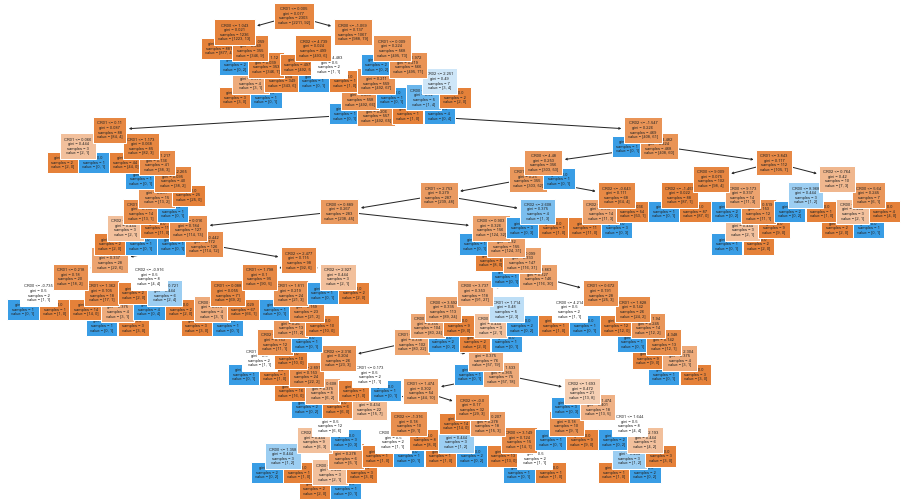

In [50]:
## Plot first trees of the ensemble
plt.figure(figsize = (16,9))
plot_tree(PCR_fit.best_estimator_[2], feature_names= INPUTS, fontsize=4, filled=True)
plt.show()

Finalmente, se pueden hallar las métricas para evaluar el éxito del modelo.

In [51]:
# model predictions in training (TR) and test (TS) sets
PCADT_fit = PCR_fit.best_estimator_[2]
y_train_pred = PCADT_fit.predict(X_train_pca).tolist()
y_test_pred = PCADT_fit.predict(X_test_pca).tolist()

# main metrics
acc_tr = metrics.accuracy_score(y_train,y_train_pred)
acc_ts = metrics.accuracy_score(y_test,y_test_pred)

acc_bal_tr = metrics.balanced_accuracy_score(y_train,y_train_pred)
acc_bal_ts = metrics.balanced_accuracy_score(y_test,y_test_pred)

dfacc_PCA =  pd.DataFrame([[acc_tr, acc_ts], [acc_bal_tr, acc_bal_ts]], index= ['Accuracy', 'Balanced accuracy'], 
                          columns=['TR', 'TS'])
print(dfacc_PCA)

print('\nMETRICS TRAINING:')
CT.confusion_matrix(y_train, y_train_pred, labels=[1,0])
print('\nMETRICS TEST SET:')
CT.confusion_matrix(y_test, y_test_pred, labels=[1,0])

                         TR        TS
Accuracy           0.992618  0.949653
Balanced accuracy  0.907609  0.640420

METRICS TRAINING:
Confusion Matrix and Statistics
	   Prediction
 Reference  1    0
         1 75   17
         0  0 2211

Accuracy: 0.99
No Information Rate: 0.93
P-Value [Acc > NIR]: 0.0
Kappa: 0.89
Mcnemar's Test P-Value: 0.0
Sensitivity: 1.0
Specificity: 0.82
Precision: 1.0
Recall: 0.82
Prevalence: 0.96
Detection Rate: 0.96
Detection prevalence: 0.97
Balanced accuracy: 0.91
F1 Score: 0.9
Positive label: 1

METRICS TEST SET:
Confusion Matrix and Statistics
	   Prediction
 Reference  1   0
         1  7  16
         0 13 540

Accuracy: 0.95
No Information Rate: 0.93
P-Value [Acc > NIR]: 0.91
Kappa: 0.3
Mcnemar's Test P-Value: 0.71
Sensitivity: 0.98
Specificity: 0.3
Precision: 0.35
Recall: 0.3
Prevalence: 0.96
Detection Rate: 0.94
Detection prevalence: 0.97
Balanced accuracy: 0.64
F1 Score: 0.33
Positive label: 1


Como comnentario final, mencionar que se han hecho varios barridos intentando simplificar el árbol y mejorar los resultados, pero los resultados son nefastos. Al intentar ajustar los parámetros del árbol pueden suceder dos cosas:
- Los resultados no son mejores que la elección al azar de la variable de salida. Por tanto, el modelo es completamente inútil.
- El modelo sufre mucho sobre entrenamiento, por lo que la capacidad de generalización es nula. Esto es loque ha sucedido en el último caso.

En particular, el hiper parámetro que más importancia tiene sobre estos dos tipos de resultado es el `min_impurity_decrease`. Esto se debe a que un valor muy grande de este parámetro hace que no pueda hacer suficientes cortes para aislar correctamente los registros con `FESTIVO = 0`. En conclusión, la descomposición de las variables de entarda usando una combinación linear de $\{C00, ..., C24\}$ no es adecuada para este problema. 

Esto no debería ser una sorpresa ya que como se ha visto en los modelos anteriores una de las variables más importantes es `DIASEM`, por lo que privar al modelo de esta variable causa muchos problemas.

#### 1.8 Compara todos los modelos creados en términos de complejidad, interpretabilidad y errores
- Discute el posible impacto que tiene en los modelos el que existan menos festivos que laborables
- Compara la complejidad en términos de nº de parámetros y estructura del modelo, variables utilizadas, importancia de las mismas
- Compara la capacidad de generalización de los modelos utilizando TS y las diferencias en las matrices de confusión
- Estudia la tasa de fallos de los modelos dependiendo del día de la semana
- Indica qué modelo o modelos son los más prometedores para poner en producción, justificando la selección

A lo largo del informe se han visto las consecuencias de tener un set de datos completamente desbalanceado. Los resultados obtenidos son mejorables en todos los casos y en alguno ligeramente mejor que la elección al azar. Esto hace que entrenar los modelos sea formidablemente complicado, ya que encontrar el balance entre sobre entrenamiento y capacidad de generalización es harto complicado. Además, dado el número de registros con `FESTIVO` = 1 no es posible hacer oversampling o undersampling por riesgo a aumentar más si cabe al sobre entrenamiento.

Para poder hacer un análisis exhaustivo de los modelos se ha resumido en la siguiente celda las tasas de precisión y precisión ajustada para todos ellos:

In [52]:
#-------------------------- NO ESCRIBAS LÍNEAS DE CÓDIGO MÁS LARGAS QUE LO QUE OCUPA ESTA LÍNEA -----------------------------|
print('Precisión de DecisionTree:\n', dfacc_DT)
print('\n\nPrecisión de Random Forest:\n', dfacc_RF)
print('\n\nPrecisión de Bagging:\n', dfacc_BT)
print('\n\nPrecisión de Gradient Boosting:\n', dfacc_GB)
print('\n\nPrecisión de PCA:\n', dfacc_PCA)
print('\n\nPrecisión de Stacking:\n', dfacc_ST)

Precisión de DecisionTree:
                          TR        TS
Accuracy           0.996092  0.967014
Balanced accuracy  0.951087  0.774471


Precisión de Random Forest:
                          TR        TS
Accuracy           0.999566  0.979167
Balanced accuracy  0.994565  0.759965


Precisión de Bagging:
                     TR        TS
Accuracy           1.0  0.984375
Balanced accuracy  1.0  0.846018


Precisión de Gradient Boosting:
                     TR        TS
Accuracy           1.0  0.984375
Balanced accuracy  1.0  0.846018


Precisión de PCA:
                          TR        TS
Accuracy           0.992618  0.949653
Balanced accuracy  0.907609  0.640420


Precisión de Stacking:
                     TR        TS
Accuracy           1.0  0.984375
Balanced accuracy  1.0  0.846018


In [53]:
def confMatrix(modelo):
    y_train_pred = modelo.predict(X_train[INPUTS])
    y_test_pred = modelo.predict(X_test[INPUTS])
    trainCM = confusion_matrix(y_train, y_train_pred, )
    testCM = confusion_matrix(y_test, y_test_pred, )
    return trainCM, testCM


DT_trainCM, DT_testCM  = confMatrix(clf)
BT_trainCM, BT_testCM  = confMatrix(bt_fit)
RF_trainCM, RF_testCM  = confMatrix(rf_fit)
GB_trainCM, GB_testCM  = confMatrix(GB_class_estim)
ST_trainCM, ST_testCM  = confMatrix(stacked_cla)
PCA_trainCM, PCA_testCM  = confMatrix(PCR_fit)
print('DecisionTree:\n',DT_trainCM, '\n', DT_testCM, '\n','--'*10)  
print('Bagging Trees:\n',BT_trainCM, '\n', BT_testCM, '\n','--'*10)  
print('Random Forest:\n',RF_trainCM, '\n', RF_testCM, '\n','--'*10)  
print('Gradient Boosting:\n',GB_trainCM, '\n', GB_testCM, '\n','--'*10)  
print('Stacking:\n',ST_trainCM, '\n', ST_testCM, '\n','--'*10)  
print('PCA:\n',PCA_trainCM, '\n', PCA_testCM, '\n','--'*10)  

DecisionTree:
 [[2211    0]
 [   0   92]] 
 [[551   2]
 [  7  16]] 
 --------------------
Bagging Trees:
 [[2211    0]
 [   0   92]] 
 [[551   2]
 [  7  16]] 
 --------------------
Random Forest:
 [[2211    0]
 [   1   91]] 
 [[552   1]
 [ 11  12]] 
 --------------------
Gradient Boosting:
 [[2211    0]
 [   0   92]] 
 [[551   2]
 [  7  16]] 
 --------------------
Stacking:
 [[2211    0]
 [   0   92]] 
 [[551   2]
 [  7  16]] 
 --------------------
PCA:
 [[2211    0]
 [  17   75]] 
 [[540  13]
 [ 16   7]] 
 --------------------


En vista de los resultados, y dado que en ningún caso la precisión en entrenamiento es similar a la de test, se puede concluir que hay sobre entrenaimento en todos los modelos. Además, en muchos casos la precisión de entrenamiento es del $100\%$, otro indicador de sobreentrenamiento. Los mejores modelos, dejándonos guiar únicamente por la precisión, son Bagging, Gradient Boosting y Random Forest con la misma precisión ajustada del $84.6\%$. Además, estos tres modelos también tienen una matriz de confusión bastante similar. Siguiendo con la matriz de confusión se ve que en todos casos la matriz de entrenamiento indica sobre entrenamiento al ser todos los modelos, únicamente a expeción del árbol usando los componentes principales, capaces de precedir con total exactitud los datos de entrenamiento.

A la hora de determinar las variables más importantes de este problema se refiere a las figuras generadas a lo largo de este informe. Tal y como se ha comentado en el capítulo del análisis de componentes principales, la variable de entrada `DIASEM` es muy importante; máxime cuando todos los modelos la colocan entre las más influyentes. Detrás de ella estarían `C14` y `C15`, pero no destaca ninguna otra variable de entrada más allá de las ya mencionadas. Con ánimo de simplificar los modelos y posiblemente obtener mejores resultados sería interesante volver a realizar este informe considerando únicamente las variables mencionadas, o realizar el análisis de componentes principales usando todo el rango de variables de entrada. 

En cuanto a interpretabilidad y sencillez de los modelos se refiere y al hilo de lo mencionado anteriormente, bagging no mejora la interpretabilidad frente a gradient boosting o random forest. Esto se debe a que a pesar de que los árboles individuales puedan ser más sencillos el gran número de ellos hace que todo lo que se gana en resultados se pierde en interpretabilidad. Además, a la hora de acoplar los modelos usando Stacking se vuelve a perder en interpretabilidad.

Si hubiera que elegir un modelo para poner en producción escogeríamos Gradient Boosting, por ser de los modelos con más precisión ajustada de entrenamiento y ser, entre los tres mejores, el más interpretable. Sin emabrgo, el modelo de Bagging también parece prometedor.

Se puede hacer un análisis de los días de la semana por los modelos de manera individual:

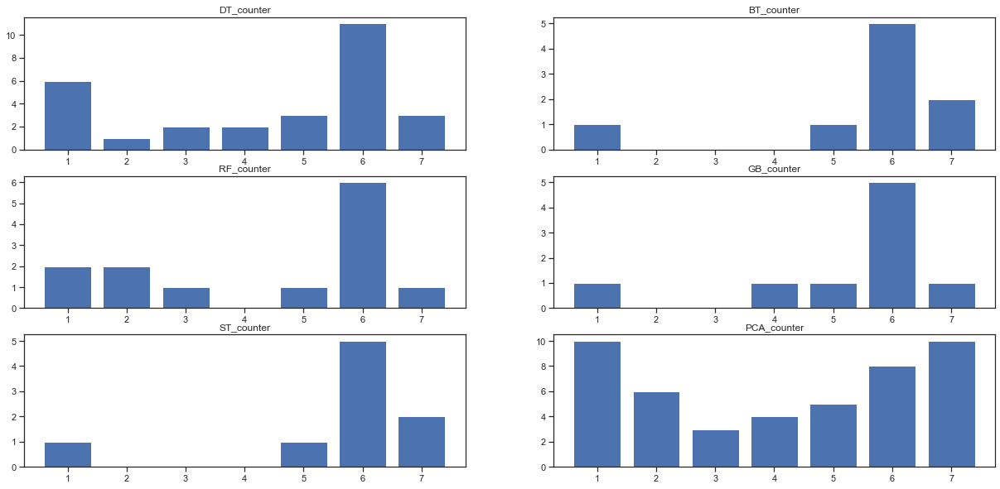

In [54]:
def modeloDIASEM(modelo):
    y_train_pred = modelo.predict(X_train[INPUTS])
    y_test_pred = modelo.predict(X_test[INPUTS])
    train = X_train[y_train_pred != y_train].DIASEM.to_list()
    test = X_test[y_test_pred != y_test].DIASEM.to_list()
    return train+test

clf = tree_fit.best_estimator_['DT']
DT_diasem = modeloDIASEM(clf)
BT_diasem = modeloDIASEM(bt_fit)
RF_diasem = modeloDIASEM(rf_fit)
GB_diasem = modeloDIASEM(GB_class_estim)
ST_diasem = modeloDIASEM(stacked_cla)
PCA_diasem = modeloDIASEM(PCR_fit)

DT_counter = Counter(DT_diasem)
BT_counter = Counter(BT_diasem) 
RF_counter = Counter(RF_diasem) 
GB_counter = Counter(GB_diasem) 
ST_counter = Counter(ST_diasem) 
PCA_counter = Counter(PCA_diasem) 

def barPlot(counter):
    plt.bar(counter.keys(), counter.values())

plt.figure(figsize = (21,10))
plt.subplot(3,2,1)
barPlot(DT_counter)
plt.title('DT_counter')

plt.subplot(3,2,2)
barPlot(BT_counter)
plt.title('BT_counter')
plt.subplot(3,2,3)
barPlot(RF_counter)
plt.title('RF_counter')
plt.subplot(3,2,4)
barPlot(GB_counter)
plt.title('GB_counter')
plt.subplot(3,2,5)
barPlot(ST_counter)
plt.title('ST_counter')
plt.subplot(3,2,6)
barPlot(PCA_counter)
plt.title('PCA_counter')

plt.show()


Se ve claramente que el análisis de componentes principales es el modelo que más tiende a fallar, tal y como se ha observado en su concepción.

O se puede hacer un resumen a ver si hay alguna tendencia global en los modelos:

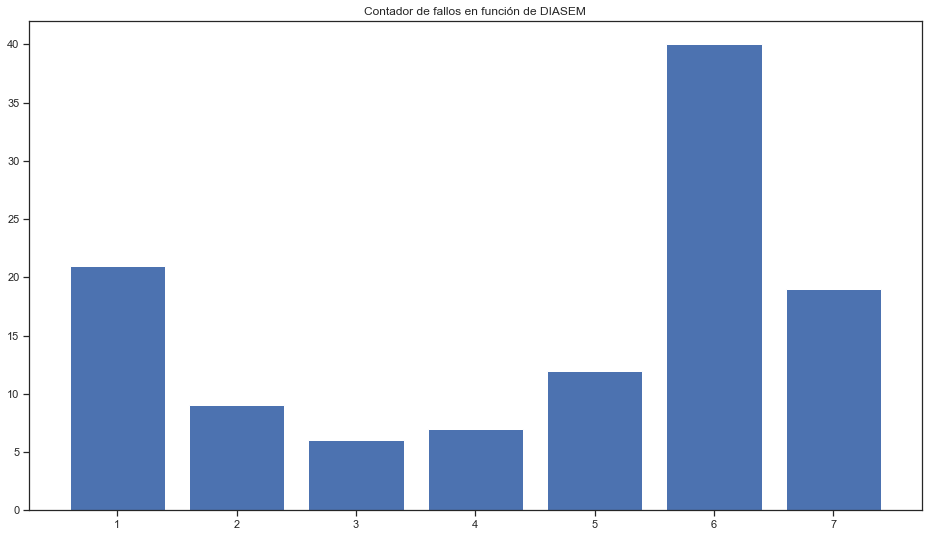

In [55]:
c = DT_counter +BT_counter +RF_counter +GB_counter +ST_counter +PCA_counter
plt.figure(figsize = (16,9))
barPlot(c)
plt.title('Contador de fallos en función de DIASEM')
plt.show()

Se ve una clara tendencia de fallo a los registros con `DIASEM` = 6, posiblemente los sábados. Esta tendencia se puede detectar también analizando las gráficas de los modelos de manera individual. Por comprobar, se puede mirar si el conjunto de datos original tiene un número de registros con `DIASEM`= 6 superior comparado con otros valores:

In [56]:
Counter(df_aju.DIASEM)

Counter({3: 412, 4: 414, 5: 416, 6: 414, 7: 408, 1: 407, 2: 408})

Se ve que no es el caso, con lo que el error se encuentra en los modelos de manera intrínseca.

---
### 2. VALIDACIÓN FINAL DE LOS MODELOS CON EL DATASET VAL_DATOS_DEM_C3

Se correpondería como si los todos los modelos creados anteriormente se ponen en producción el 1 enero de 2022 y se tienen estimando la festividad durante todo el año para ver qué tal funcionan.

Recuerda, no se debería ver ningún resultado sobre este dataset hasta haber completado todos los apartados anteriores.

Carga datos de validación

In [57]:
#--------------------------NO ESCRIBAS LÍNEAS DE CÓDIGO MÁS LARGAS QUE LO QUE OCUPA ESTA LÍNEA -----------------------------|

df_val = pd.read_csv('VAL_DATOS_DEM_C3.csv')

# parseamos la fecha (cadena) para que sea un datetime con formato dd/mm/yyyy 
# esta variable NO se puede utilizar como entrada en los modelos
df_val.FECHA = pd.to_datetime(df_val.FECHA, format='%d/%m/%Y') 
s=df_val.loc[:,'FECHA']
df_val['FECHA'] =  s.dt.date

# eliminamos las variables que no se pueden usar como entradas en los modelos
del df_val['ANNO']
del df_val['DIA']

print('Tamaño de df_val con los datos cargados:', df_val.shape)
print('Dataframe con todos los datos leidos (filas: días, columnas: variables):')
print(df_val)

Tamaño de df_val con los datos cargados: (357, 30)
Dataframe con todos los datos leidos (filas: días, columnas: variables):
          FECHA      CR00      CR01      CR02      CR03      CR04      CR05  \
0    2022-01-01  0.038935  0.037313  0.035291  0.033673  0.032924  0.033235   
1    2022-01-02  0.035271  0.033313  0.031889  0.031411  0.031302  0.031975   
2    2022-01-03  0.033756  0.032003  0.030669  0.030051  0.030199  0.031280   
3    2022-01-04  0.034484  0.032505  0.031375  0.030540  0.030431  0.031324   
4    2022-01-05  0.034669  0.032213  0.030933  0.030382  0.030527  0.031611   
..          ...       ...       ...       ...       ...       ...       ...   
352  2022-12-27  0.033279  0.031139  0.029907  0.029433  0.029757  0.030972   
353  2022-12-28  0.033250  0.031186  0.029934  0.029447  0.029821  0.030942   
354  2022-12-29  0.033718  0.031695  0.030290  0.029717  0.030014  0.031075   
355  2022-12-30  0.033673  0.031494  0.030124  0.029639  0.029629  0.030732   
356  20

#### 2.1. Compara los errores obtenidos en validación con los observados previamente en ajuste/test
- Una vez terminados todos los ajustes de los modelos en el apartado 1.1., ejecuta los mismos para estimar si los días de 2022 son festivos o no (conjunto df_val)
- Muestra los resultados de clasificación obtenidos en el nuevo dataset (accuray y tablas de confusión de cada modelo)
- Discute si los errores obtenidos son coherentes con lo que se esperaba como resultado de los análisis previos para estimar la capacidad de generalización de cada uno de los modelos

In [58]:
#--------------------------NO ESCRIBAS LÍNEAS DE CÓDIGO MÁS LARGAS QUE LO QUE OCUPA ESTA LÍNEA -----------------------------|
#Preapración de los conjuntos de validación
X_val = df_val.copy()
y_val = df_val['FESTIVO'].copy()
del X_val['FESTIVO']

In [59]:
#--------------------------NO ESCRIBAS LÍNEAS DE CÓDIGO MÁS LARGAS QUE LO QUE OCUPA ESTA LÍNEA -----------------------------|
def validationMeter(model):
    '''
    Toma como entrada un modelo y devuelve un DataFrame con las métricas de validación.
    '''
    y_val_pred = model.predict(X_val[INPUTS_DT]).tolist()
    acc_val = metrics.accuracy_score(y_val,y_val_pred)
    acc_bal_val = metrics.balanced_accuracy_score(y_val,y_val_pred)
    val_dfacc_DT =  pd.DataFrame([[acc_val],[acc_bal_val]], 
                                 index= ['Precisión', 'Precisión balanceada'],  
                                 columns=['VAL'])
    return val_dfacc_DT

def confMatrixValidation(modelo):
    y_val_pred = modelo.predict(X_val[INPUTS])
    valCM = confusion_matrix(y_val, y_val_pred, )
    return valCM

clf = tree_fit.best_estimator_['DT']
print('Matriz de precisión de Decision Tree:\n', validationMeter(clf))
print('\n\nMatriz de precisión de Bagged Trees:\n', validationMeter(bt_fit))
print('\n\nMatriz de precisión de Random Forest:\n', validationMeter(rf_fit))
print('\n\nMatriz de precisión de Gradient Boosting:\n', validationMeter(GB_class_estim))
print('\n\nMatriz de precisión de Stacking:\n', validationMeter(stacked_cla))
print('\n\nMatriz de precisión de PCA:\n', validationMeter(PCR_fit))
print('--'*20)
print('Matriz de confusión de Decision Tree:\n', confMatrixValidation(clf))
print('\n\nMatriz de confusión de Bagged Trees:\n', confMatrixValidation(bt_fit))
print('\n\nMatriz de confusión de Random Forest:\n', confMatrixValidation(rf_fit))
print('\n\nMatriz de confusión de Gradient Boosting:\n', 
      confMatrixValidation(GB_class_estim))
print('\n\nMatriz de confusión de Stacking:\n', confMatrixValidation(stacked_cla))
print('\n\nMatriz de confusión de PCA:\n', confMatrixValidation(PCR_fit))



Matriz de precisión de Decision Tree:
                            VAL
Precisión             0.969188
Precisión balanceada  0.665205


Matriz de precisión de Bagged Trees:
                            VAL
Precisión             0.966387
Precisión balanceada  0.600000


Matriz de precisión de Random Forest:
                            VAL
Precisión             0.960784
Precisión balanceada  0.533333


Matriz de precisión de Gradient Boosting:
                            VAL
Precisión             0.980392
Precisión balanceada  0.766667


Matriz de precisión de Stacking:
                            VAL
Precisión             0.971989
Precisión balanceada  0.666667


Matriz de precisión de PCA:
                            VAL
Precisión             0.907563
Precisión balanceada  0.569298
----------------------------------------
Matriz de confusión de Decision Tree:
 [[341   1]
 [ 10   5]]


Matriz de confusión de Bagged Trees:
 [[342   0]
 [ 12   3]]


Matriz de confusión de Random Forest:
 [[3

Los resultados obtenidos para la precisión ajustada se corresponden con lo esperado a la hora de hacer la comparación de modelos, ya que el GradientBoosting es el que mejor ha sido capaz de generalizar. Sin embargo, parece que las esperanzas en Bagging han caído en saco roto ya que ha sido el tercero peor en cuanto a rendimiento en validación. Sorprendentemente, el modelo que usa las componentes principales no es el peor a pesar de que en los conjuntos de entrenamiento lo haya sido.

En conclusión, la decisión de poner en producción el modelo de Gradient Boosting hubiera sido adecuada vistos los resultados.

#### 2.2. Análisis de los días peor clasificados
- Indica en una tabla la lista de los días que se han clasificado incorrectamente por cada uno de los modelos considerados
- Comenta las posibles diferencias y semejanzas, intentando buscar una justificación de por qué ha ocurrido el error de clasificación
- Muestra gráficamente los perfiles de 24 horas de los 3 días más difíciles de clasificar para los modelos, comparándolos con lo esperado según el día de la semana correspondiente

In [60]:
#--------------------------NO ESCRIBAS LÍNEAS DE CÓDIGO MÁS LARGAS QUE LO QUE OCUPA ESTA LÍNEA -----------------------------|
#--------------------------NO ESCRIBAS LÍNEAS DE CÓDIGO MÁS LARGAS QUE LO QUE OCUPA ESTA LÍNEA -----------------------------|
lista = []
# Create a DataFrame with the true labels and predicted labels for the training and test sets
y_train_df = pd.DataFrame({'True label': y_train, 'Predicted label': y_train_stack})
y_test_df = pd.DataFrame({'True label': y_test, 'Predicted label': y_test_stack})

# Filter out the rows where the predicted label does not match the true label
train_errors = y_train_df[y_train_df['True label'] != y_train_df['Predicted label']]
test_errors = y_test_df[y_test_df['True label'] != y_test_df['Predicted label']]
print('\nTest set errors:')
print(test_errors.head())
print(len(test_errors))
for index, row in test_errors.iterrows():
    festivo_value = df_aju.loc[index, 'FESTIVO']
    diasem_value = df_aju.loc[index, 'DIASEM']
    dia_value = df_aju.loc[index, 'FECHA']
    test_errors.at[index, 'FESTIVO'] = festivo_value
    test_errors.at[index, 'DIASEM'] = diasem_value
    test_errors.at[index, 'FECHA'] = dia_value

lista.extend(test_errors.index.tolist())
test_errors.head()

# Count the number of occurrences of each DIASEM value in the test_errors DataFrame
counts_by_diasem = test_errors['DIASEM'].value_counts()

# Print the counts by DIASEM
print('Counts by DIASEM:')
print(counts_by_diasem)


Test set errors:
     True label  Predicted label
1698          1                0
581           1                0
504           1                0
1253          0                1
2387          1                0
9
Counts by DIASEM:
6.0    5
7.0    2
1.0    1
5.0    1
Name: DIASEM, dtype: int64


C:\Users\juanm\AppData\Local\Temp\ipykernel_4224\1613929594.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_errors.at[index, 'FESTIVO'] = festivo_value
C:\Users\juanm\AppData\Local\Temp\ipykernel_4224\1613929594.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_errors.at[index, 'DIASEM'] = diasem_value
C:\Users\juanm\AppData\Local\Temp\ipykernel_4224\1613929594.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_

In [61]:
# Nos quedamos con las observaciones erroneas
df_selected = df_aju.loc[lista]
df_selected.head()

,FECHA,CR00,CR01,CR02,CR03,CR04,CR05,CR06,CR07,CR08,...,CR19,CR20,CR21,CR22,CR23,MES,DIASEM,FESTIVO,TMIN,TMAX
1698,2018-09-15,0.037157,0.034392,0.032625,0.031984,0.031603,0.032042,0.033675,0.035665,0.039242,...,0.047375,0.049886,0.048206,0.043791,0.039325,9,6,1,21.6,29.7
581,2015-08-15,0.038045,0.034872,0.032762,0.031755,0.031476,0.031918,0.033586,0.034543,0.038440,...,0.048276,0.049129,0.050123,0.045807,0.041846,8,6,1,21.4,29.1
504,2015-05-30,0.037253,0.034279,0.032447,0.031560,0.031418,0.032238,0.033361,0.034527,0.039621,...,0.047161,0.047713,0.049249,0.045416,0.040743,5,6,1,18.3,27.5
1253,2017-06-25,0.039062,0.036897,0.034043,0.032250,0.032586,0.032540,0.033941,0.034821,0.038740,...,0.048409,0.048161,0.047886,0.043221,0.037520,6,7,0,23.0,32.4
2387,2020-08-15,0.037837,0.035099,0.033299,0.032365,0.032168,0.032530,0.034100,0.035147,0.038936,...,0.045483,0.047178,0.048793,0.044791,0.040792,8,6,1,21.3,29.7


In [62]:
# Guardampos el índice de las observaciones
indx_error = df_selected.index.tolist()

In [63]:
# Nos quedamos con las observaciones que son festivos
df_selected = df_selected[df_selected['FESTIVO'] == 1]

In [64]:
# Nos quedamos con las observaciones que no son festivos
df_not_selected = df_aju.loc[~df_aju.index.isin(indx_error)]
df_not_selected = df_not_selected[df_not_selected['FESTIVO'] == 0]
df_not_selected.head()

,FECHA,CR00,CR01,CR02,CR03,CR04,CR05,CR06,CR07,CR08,...,CR19,CR20,CR21,CR22,CR23,MES,DIASEM,FESTIVO,TMIN,TMAX
1,2014-01-02,0.033950,0.030996,0.029517,0.028966,0.029165,0.030150,0.032944,0.036510,0.041196,...,0.055820,0.054451,0.051482,0.046145,0.040880,1,4,0,12.0,20.1
2,2014-01-03,0.035463,0.032112,0.030292,0.029521,0.029450,0.030515,0.033188,0.036656,0.041052,...,0.055230,0.053520,0.050286,0.045412,0.040025,1,5,0,13.2,21.0
3,2014-01-04,0.035959,0.032772,0.031034,0.030178,0.030135,0.030782,0.032598,0.034982,0.039299,...,0.053757,0.052620,0.049973,0.044970,0.040386,1,6,0,14.4,23.4
4,2014-01-05,0.037506,0.034148,0.031878,0.031126,0.030930,0.031604,0.033066,0.034803,0.038758,...,0.052902,0.051481,0.049655,0.045730,0.040905,1,7,0,12.8,23.1
6,2014-01-07,0.033978,0.031488,0.030125,0.029326,0.029369,0.030591,0.033306,0.037551,0.041920,...,0.055453,0.054602,0.051538,0.045112,0.039318,1,2,0,12.6,21.6


Graficamos los valores de demanda por horas

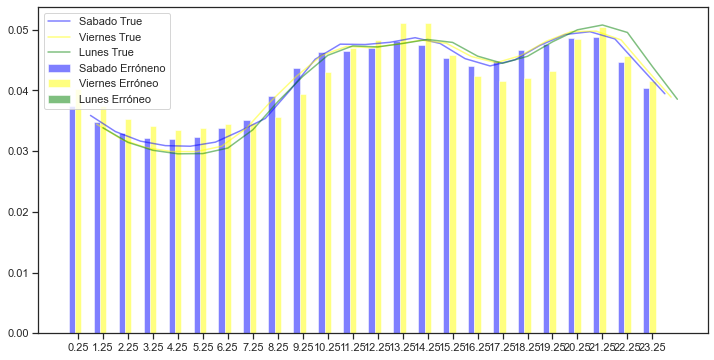

In [65]:
bar_width = 0.25

# Filter the dataframe by DIASEM values
df_diasem_6 = df_selected[df_selected['DIASEM'] == 6]
df_diasem_5 = df_selected[df_selected['DIASEM'] == 5]
df_diasem_1 = df_selected[df_selected['DIASEM'] == 1]

# Calculate the mean for each hour
mean_diasem_6 = df_diasem_6.iloc[:, 1:25].mean()
mean_diasem_5 = df_diasem_5.iloc[:, 1:25].mean()
mean_diasem_1 = df_diasem_1.iloc[:, 1:25].mean()

# Filter the dataframe by non-DIASEM values
df_not_diasem_6 = df_not_selected[df_not_selected['DIASEM'] == 6]
df_not_diasem_5 = df_not_selected[df_not_selected['DIASEM'] == 5]
df_not_diasem_1 = df_not_selected[df_not_selected['DIASEM'] == 1]

# Calculate the mean for each hour
mean_not_diasem_6 = df_not_diasem_6.iloc[:, 1:25].mean()
mean_not_diasem_5 = df_not_diasem_5.iloc[:, 1:25].mean()
mean_not_diasem_1 = df_not_diasem_1.iloc[:, 1:25].mean()

# Create x values for bars
x_diasem_6 = np.arange(len(mean_diasem_6.index))
x_diasem_5 = [x + bar_width for x in x_diasem_6]
x_diasem_1 = [x + bar_width for x in x_diasem_5]
x_not_diasem_6 = [x + bar_width for x in x_diasem_1]
x_not_diasem_5 = [x + bar_width for x in x_not_diasem_6]
x_not_diasem_1 = [x + bar_width for x in x_not_diasem_5]

# Create the figure and axis objects
fig, ax = plt.subplots(figsize=(12,6))

# Plot bars for each value of DIASEM
ax.bar(x_diasem_6, mean_diasem_6.values, color='blue', alpha=0.5, width=bar_width, label='Sabado Erróneno')
ax.bar(x_diasem_5, mean_diasem_5.values, color='yellow', alpha=0.5, width=bar_width, label='Viernes Erróneo')
ax.bar(x_diasem_1, mean_diasem_1.values, color='green', alpha=0.5, width=bar_width, label='Lunes Erróneo')

# Plot lines for each value of non-DIASEM
ax.plot(x_not_diasem_6, mean_not_diasem_6.values, color='blue', alpha=0.5, label='Sabado True')
ax.plot(x_not_diasem_5, mean_not_diasem_5.values, color='yellow', alpha=0.5, label='Viernes True')
ax.plot(x_not_diasem_1, mean_not_diasem_1.values, color='green', alpha=0.5, label='Lunes True')

# Set x-axis tick labels
ax.set_xticks(x_diasem_5)
plt.legend()
plt.show()